# **NEURAL NETWORKS AND DEEP LEARNING**

---
A.A. 2021/22 (6 CFU) - Dr. Alberto Testolin, Dr. Umberto Michieli
---


#### *Simionato Giuseppe (2029013)*

# **Homework 1 - Supervised Deep Learning**

## General overview
In this homework you will learn how to implement and test simple neural network models for solving supervised problems. It is divided in two tasks.

* **Regression task**: 
the regression model will consist in a simple function approximation problem, similar to the one discussed during the Lab practices. 

* **Classification task**: 
the classification model will consist in a simple image recognition problem, where the goal is to correctly classify images of Zalando's article images (Fashion MNIST). 

In both cases, but especially for the classification problem, you should explore the use of advanced optimizers and regularization methods (e.g., initialization scheme, momentum, ADAM, early stopping, L2, L1 / sparsity, dropout…) to improve convergence of stochastic gradient descent and promote generalization. Learning hyperparameters should be tuned using appropriate search procedures, and final accuracy should be evaluated using a cross-validation setup. For the image classification task, you can also implement more advanced convolutional architectures and explore feature visualization techniques to better understand how the deep network is encoding information at different processing layers.



## Technical notes
The homework should be implemented in Python using the PyTorch framework. The student can explore additional libraries and tools to implement the models; however, please make sure you understand the code you are writing because during the exam you might receive specific questions related to your implementation. The entire source code required to run the homework must be uploaded as a compressed archive in a Moodle section dedicated to the homework.If your code will be entirely included in a single Python notebook, just upload the notebook file.




## Final report
Along with the source code, you must separately upload a PDF file containing a brief report of your homework. The report should include a brief Introduction on which you explain the homework goals and the main implementation strategies you choose, a brief Method section where you describe your model architectures and hyperparameters, and a Result section where you present the simulation results. Total length should not exceed 6 pages, though you can include additional tables and figures in a final Appendix (optional). The report must be self-contained, so please make sure that all relevant results are explicitly included in the report / notebook.




## Grade
The maximum grade for this homework will be **8 points**. Points will be assigned based on the correct implementation of the following items:
*	2 pt: implement basic regression and classification tasks
*	2 pt: explore advanced optimizers and regularization methods (both tasks)
*	1 pt: optimize hyperparameters using grid/random search and cross-validation (both tasks)
*	2 pt: implement CNN for classification task
*	1 pt: visualize weight histograms, activation profiles and receptive fields



## Deadline
The complete homework (notebook or source code + report) must be submitted through Moodle at least 10 days before the chosen exam date.


# Libraries

In [1]:
!pip install pandas_bokeh

!pip install optuna

!pip install trains

  Using cached pandas_bokeh-0.5.5-py2.py3-none-any.whl (29 kB)
     |████████████████████████████████| 18.5 MB 17.4 MB/s eta 0:00:01     |████████████████████████████▏   | 16.3 MB 17.4 MB/s eta 0:00:01
     |████████████████████████████████| 3.1 MB 37.6 MB/s eta 0:00:01
  Attempting uninstall: pillow
    Found existing installation: Pillow 6.2.1
    Uninstalling Pillow-6.2.1:
      Successfully uninstalled Pillow-6.2.1
     |████████████████████████████████| 308 kB 3.9 MB/s eta 0:00:01
     |████████████████████████████████| 80 kB 11.6 MB/s eta 0:00:01
     |████████████████████████████████| 209 kB 20.9 MB/s eta 0:00:01
     |████████████████████████████████| 1.6 MB 20.1 MB/s eta 0:00:01
     |████████████████████████████████| 156 kB 20.8 MB/s eta 0:00:01
     |████████████████████████████████| 75 kB 6.1 MB/s  eta 0:00:01
     |████████████████████████████████| 49 kB 6.2 MB/s  eta 0:00:01
     |████████████████████████████████| 112 kB 14.6 MB/s eta 0:00:01
     |███████████████████████

     |████████████████████████████████| 86 kB 8.8 MB/s  eta 0:00:01
  Using cached future-0.18.2.tar.gz (829 kB)
  Created wheel for future: filename=future-0.18.2-py3-none-any.whl size=491070 sha256=eda0a1e07c24facd32ae13d1d05f921e44eeffac10b34603b1bd90c8904eca7c
  Stored in directory: /home/giuseppe/.cache/pip/wheels/8e/70/28/3d6ccd6e315f65f245da085482a2e1c7d14b90b30f239e2cf4
Successfully built future


In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px

import sklearn
import sklearn.model_selection
from sklearn.manifold import TSNE
from sklearn.model_selection import KFold
from sklearn.metrics import confusion_matrix

from tqdm.notebook import tqdm
import random
import optuna
import imageio
import IPython as ip
from PIL import Image
import seaborn

import pandas_bokeh
from bokeh.plotting import figure, show
from bokeh.io import output_notebook
output_notebook()

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader
import torchvision
from torchvision import transforms
from torchsummary import summary

from trains.automation import UniformParameterRange, UniformIntegerParameterRange
from trains.automation import HyperParameterOptimizer
from trains.automation.optuna import OptimizerOptuna

seed = 101325

Loading BokehJS ...

# **** Regression task ****

The work of this first task follows these steps:
- Analysis and **pre-processing** of the dataset
- Definition of the **model** and of the useful functions for the training
- First **training** and testing of the model
- Analysis of the trained network
- **Hyper-parameters** optimization both using manual and automatic implementation
- **K-fold** cross validation with the best parameters

### **Regularization methods:** 
Some regularization methods will be used and discussed in the following code:
- batch normalization
- dropout
- adam optimizer 
- the **weight_decay** parameter which applies L2 regularization while initialising optimizer. This adds regularization term to the loss function, with the effect of shrinking the parameter estimates, making the model simpler and less likely to overfit
- **weights inizialization** where the weights of the network are inizialized depending on the layer's type.
- **sparsity** (L1 regularizer), this method is implemented thanks to a function defined by scratch which compute the sum of the module of all parameters. The result of this function is multiplied by a parameter and added to the loss.

## Guidelines

* The goal is to train a neural network to approximate an unknown function:
$$ 
f:\mathbb{R}→\mathbb{R} \\
x↦y=f(x) \\
\text{network}(x) \approx f(x)
$$
* As training point, you only have noisy measures from the target function.
$$
\hat{y} = f(x) + noise
$$
* Consider to create a validation set from you training data, or use a k-fold cross-validation strategy. You may find useful these functions from the `scikit-learn` library:
    - [train_test_split](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html)
    - [KFold](https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.KFold.html#sklearn.model_selection.KFold) 

## Dataset

The goal is to train a neural network to approximate an unknown function and to do this it is of paramount importance to know how the dataset is made. After loading the data, they are stored in a pandas dataframe to allow an easier manipulation and a better visualization with a table.

The following cell of code will download the dataset and make it available in the local folder `regression_dataset`. There are two files:

* `regression_dataset/train_data.csv`
* `regression_dataset/test_data.csv`

Use them to train and test your model. Each row contains two values, respactively the input and the target (label).

In [ ]:
!wget -P regression_dataset https://gitlab.dei.unipd.it/michieli/nnld-2021-22-lab-resources/-/raw/main/homework1/train_data.csv
!wget -P regression_dataset https://gitlab.dei.unipd.it/michieli/nnld-2021-22-lab-resources/-/raw/main/homework1/test_data.csv 

--2021-12-26 10:26:30--  https://gitlab.dei.unipd.it/michieli/nnld-2021-22-lab-resources/-/raw/main/homework1/train_data.csv
Resolving gitlab.dei.unipd.it (gitlab.dei.unipd.it)... 147.162.2.85
Connecting to gitlab.dei.unipd.it (gitlab.dei.unipd.it)|147.162.2.85|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3776 (3.7K) [text/plain]
Saving to: ‘regression_dataset/train_data.csv’

train_data.csv      100%[===================>]   3.69K  --.-KB/s    in 0s      

2021-12-26 10:26:31 (72.3 MB/s) - ‘regression_dataset/train_data.csv’ saved [3776/3776]

--2021-12-26 10:26:31--  https://gitlab.dei.unipd.it/michieli/nnld-2021-22-lab-resources/-/raw/main/homework1/test_data.csv
Resolving gitlab.dei.unipd.it (gitlab.dei.unipd.it)... 147.162.2.85
Connecting to gitlab.dei.unipd.it (gitlab.dei.unipd.it)|147.162.2.85|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3788 (3.7K) [text/plain]
Saving to: ‘regression_dataset/test_data.csv’

test_data.csv 

The downloaded data are stored in a pandas dataframe and the tables of their main features are reported. The number of total points for the two dataset is the same, 100, but a part of the training set will be used for the validation. The training data seem to be more ditributued along the abscissa axis. In fact, the two sets are both centered in zero (as we can see from the mean), but the std of the former is bigger than latter even if the max and min are similar.

In [ ]:
train_df = pd.read_csv('regression_dataset/train_data.csv')
test_df = pd.read_csv('regression_dataset/test_data.csv')
train_df.describe()

,input,label
count,100.000000,100.000000
mean,0.535661,2.826761
std,3.511726,1.962990
min,-4.915863,-3.742970
25%,-3.255942,1.677844
50%,0.037716,2.663394
75%,4.143882,3.727911
max,4.977516,7.199304


In [ ]:
test_df.describe()

,input,label
count,100.000000,100.000000
mean,-0.088111,2.572386
std,2.924814,1.697217
min,-4.999868,-2.999869
25%,-2.733220,1.781779
50%,0.029972,2.715547
75%,2.208296,3.767334
max,4.894875,6.335996


How to get a specific sample:

In [ ]:
sample_index = 0
input = train_df.iloc[sample_index]['input']
label = train_df.iloc[sample_index]['label']

print(f"SAMPLE AT INDEX {sample_index}")
print(f"INPUT: {input}")
print(f"LABEL: {label}")

SAMPLE AT INDEX 0
INPUT: -4.787870188090535
LABEL: -1.216803599957529


The training and testing points are already divided in two sets and are represented, thanks to the bokeh library, in an interactive plot. There is in green the training set and in red the test one. Looking at the plot, we can notice a first important thing: not all the regions of the domain are covered by the training points or in other words the two sets are not distributed uniformly along the x-axis. For our algorithm, it will be difficult to learn properly the trend of the function around these regions, as for example near the sample x = -2.

In [ ]:
p = figure(plot_width=1000, plot_height=600, title="Dataset points")
p.title.text_font_size = "30px"

p.scatter(x = train_df.input, y=train_df.label, color="green", legend_label='training set', marker='circle', size=7, alpha=0.75)
p.scatter(x = test_df.input, y=test_df.label, color="red", legend_label='test set', marker='circle', size=7, alpha=0.75)

p.legend.click_policy='hide'
p.legend.location='top_left'
p.xaxis.axis_label = 'input'
p.yaxis.axis_label = 'label'
p.xaxis.axis_label_text_font_size = '15pt'
p.yaxis.axis_label_text_font_size = '15pt'
show(p)

### Pre processing

The downloaded dataset are now processed and prepared in order to have the data ready for training the model. A `torch.utils.data.Dataset` class is created to load and manipulate the data in a more flexible and easy way. It contains the following methods:

* `__init__` to initialize the dataset. It is loaded using pandas and stored in a dataframe.
* `__len__` returns the size of the dataset.
* `__getitem__` to support indexing. It is used to get the i-th sample thanks to the pandas dataframe property `iloc`.

It is also created the `ToTensor` class to convert the data into a pytorch tensor very important to exploit the functionalities of the pytorch models.

In [ ]:
class CsvDataset(Dataset):

    def __init__(self, csv_file, transform=None):
        # Load the file as a pandas dataframe
        self.transform = transform
        self.data = pd.read_csv(csv_file)
        #self.input = self.data['input']
        #self.labels = self.data['label']

    def __len__(self):
        # The length of the dataset is simply the length of the self.data list
        return len(self.data)

    def __getitem__(self, idx):

        sample = self.data.iloc[idx]
        #label = self.data.iloc[idx]['label']
        if self.transform:
            sample = self.transform(sample)
        return sample
        
class ToTensor(object):
    """Convert sample to Tensors."""

    def __call__(self, sample):
        x, y = sample
        return torch.tensor([x]).float(), torch.tensor([y]).float()

Now that we have a dataset to work with and we have defined the transformation to apply to our data, we can use the `transform.Compose` to combine them in a unique variable. In this case, we only convert the data to tensor. 
Thanks to the dataset class, we can apply directly the transofmations when the data are loaded, enabling a faster manipulation of the samples.

In [ ]:
composed_transform = transforms.Compose([ToTensor()])

train_dataset = CsvDataset('regression_dataset/train_data.csv', transform=composed_transform)
test_dataset  = CsvDataset('regression_dataset/test_data.csv', transform=composed_transform)

# print a random sample using the dataset
idx = np.random.randint(0, len(train_dataset))
print(f'TRAINING DATA -> Input: %0.3f, Label: %0.3f' %(train_dataset[idx]))
print(f'TEST DATA     -> Input: %0.3f, Label: %0.3f' %(test_dataset[idx]))

TRAINING DATA -> Input: -3.855, Label: 2.621
TEST DATA     -> Input: 4.233, Label: 3.403


The `torch.utils.data.DataLoader` iterator provides some useful features to manipulate our dataset and to preprocess properly for our training. Thanks to this pytorch tool, we can:

* Batching the data
* Shuffling the data
* Load the data in parallel using multiprocessing workers

Before the Dataloader, we split the training dataset in two parts (80% of the whole dataset) and we create a validation set (20% of the whole dataset). The function used for the splitting is `sklearn.model_selection.train_test_split` provided by the sklearn library (https://scikit-learn.org/stable/modules/generated/sklearn.model_selection.train_test_split.html). The data are shuffled and taken randomly with a specific seed to allow reproducible results.


In [ ]:
# split the training dataset in train and val
N = len(train_dataset)
N_train = int(0.8*len(train_dataset))
N_val = N - N_train

train, val = sklearn.model_selection.train_test_split(train_dataset, test_size=N_val, train_size=N_train, 
                                             random_state=seed, shuffle=True, stratify=None)


batch_size = 14
num_workers = 2
train_dataloader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_dataloader  = DataLoader(val, batch_size=len(val), shuffle=False, num_workers=num_workers)
test_dataloader  = DataLoader(test_dataset,  batch_size=len(test_dataset), shuffle=False, num_workers=num_workers)

print('Size of the training set:', N_train)
print('Size of a batch of the training set:  ', len(train_dataloader))
print('\nSize of the validation set:', N_val)
print('Size of a batch of the validation set:', len(val_dataloader))
print('\nSize of the test set:', len(test_dataset))
print('Size of a batch of the test set:      ', len(val_dataloader))

Size of the training set: 80
Size of a batch of the training set:   6

Size of the validation set: 20
Size of a batch of the validation set: 1

Size of the test set: 100
Size of a batch of the test set:       1


## Definition of the model

The **architecture of the model** used for the regression task is composed by the input later, three hidden linear layers and the output layer.\
The layers are followed by the **activation function**, in this case we have chosen the ReLU function.\
Each hidden layer is also includes the **dropout layer** which randomly sets input units to 0 with a given probability p at each step during training time. This procedure helps to prevent overfitting. Inputs not set to 0 are scaled up by 1/(1 - p) such that the sum over all inputs is unchanged.\

After the first three layers there should be a **batchnormalization layer** which applies a transformation that maintains the mean output close to 0 and the output standard deviation close to 1. This layer has been removed because it does not lead to some beneficial effects for the regularization of the training: indeed we expected a stabilization of the learning process and a dramatically reduction of the number of training epochs required to train the network, but probably limiting the parameters this layer prevented them to learn properly the target function. \

The class of the network is made also of two functions: 

- `training_step` : it is used to compute the loss during the training procedure and allows to track the gradient 

- `validation_step` : it is used to compute the loss during the validation/test procedure and thanks to the `torch.tensor.detach` method the gradient is not computed.This method constructs a new view on a tensor which is declared not to need gradients, i.e., it is to be excluded from further tracking of operations

\

We can notice that this is not a deep architecturea nd the main reason lies in the avaiable dataset. The samples are not too much for training deep architectures with too many parameters: hence we want to prevent overfitting due to a too complex model.

In [ ]:
# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f"Training device: {device}")

Training device: cuda


In [ ]:
# Network definition
class Net(nn.Module):
    
    def __init__(self, Ni, Nh1, Nh2, No, p):
        """
        Ni - Input size
        Nh1 - Neurons in the 1st hidden layer
        Nh2 - Neurons in the 2nd hidden layer
        Nh2 - Neurons in the 3rd hidden layer
        No - Output size
        """
        super().__init__()
        
        print('Network initialized')

        self.fc1 = nn.Linear(in_features=Ni, out_features=Nh1)
        self.fc2 = nn.Linear(in_features=Nh1, out_features=Nh2)
        self.fc3 = nn.Linear(in_features=Nh2, out_features=Nh2)
        self.act1 = nn.ReLU()
        self.dropout = nn.Dropout(p)
        self.batchnorm1 = nn.BatchNorm1d(Nh1)
        self.batchnorm2 = nn.BatchNorm1d(Nh2)
        self.out = nn.Linear(in_features=Nh2, out_features=No)
        
    def forward(self, x):
        x = self.dropout(self.act1(self.fc1(x)))
        #x = self.dropout(self.act1(self.batchnorm2(self.fc2(x))))
        #x = self.dropout(self.act1(self.batchnorm2(self.fc3(x))))
        x = self.dropout(self.act1(self.fc2(x)))
        x = self.dropout(self.act1(self.fc3(x)))
        x = self.out(x)
        return x

    def training_step(self, batch, loss_function):
        inputs, labels = batch
        x = self(inputs)
        loss_fn = loss_function()
        loss = loss_fn(x, labels)
        return loss
 
    def validation_step(self, batch, loss_function):
        inputs, labels = batch
        x = self(inputs)
        loss_fn = loss_function()
        loss = loss_fn(x, labels)
        return loss.detach()

In the following are defined the functions to train and evaluate the model. 
We decided to separate the function where the loop over the epoches is performed from the function where the validation dataset (or test dataset) is evaluated. This is done mainly because the two procedures even if are similar they are deeply different: indeed when we compute the loss over the training set we are tracking the gradient and updating the parameters. If the two procedures are separated the code is more flexible for possible changes.
- `evaluate`: this function is used, as already mentioned, to compute the loss without keeping track of the gradient and so it has the unique goal to evaluate the performances of our model;
- `fit`: when we call this function we are training the model and for this reason the input parameters have to include the *model*, the *train and validation dataloaders*, the *epochs*, but also some important hyper-parameters to properly tune to obtain the best performances, like the *optimizer*, the *learning rate (lr)*, the *weights decay* (L2 regularizer), the loss function and the *sparsity parameter* (L1 regularizer). The fit function returns in output the list of all training and validation loss, but also the number of epoch and validation loss of the minimum value that the error has reached.
The last parameter, *verbose*, enable the plot of the function inferred by the algorithm with the training and test data. \

The other two functions here defined are used for the regularization:
- `initialize_weights`: if the layer is *convolutional*, the xavier initialization method assignes to the weights a random number with a uniform probability distribution between the range $-(1/\sqrt{n})$ and $1/\sqrt{n}$, where n is the number of inputs to the node. If the layer is *linear*, the kaiming inizialization assignes to the weights a random value sampled from a zero-centered Gaussian distribution with standard deviation of $\sqrt{2/n}$: this is an initialization method for neural networks that takes into account the non-linearity of activation functions, such as ReLU activations. Finally, if there is a *batchnormalization* layer the value of the weights are inizialized to a constant value equal to one
- `sparse_loss`: this function compute the value to add to the loss as already described

In [ ]:
# initialize the weights depending on the layer's type
def initialize_weights(m):
    if isinstance(m, nn.Conv2d):
      nn.init.xavier_uniform_(m.weight.data)
    elif isinstance(m, nn.BatchNorm2d):
      nn.init.constant_(m.weight.data, 1)
    elif isinstance(m, nn.Linear):
      nn.init.kaiming_uniform_(m.weight.data)

In [ ]:
# define the sparse loss function
def sparse_loss(model):
    l1_parameters = []
    for parameter in model.parameters():
      l1_parameters.append(parameter.view(-1))
    loss = torch.abs(torch.cat(l1_parameters)).sum()
    return loss

In [ ]:
def evaluate(model, loader, loss_function=nn.MSELoss):
    val_loss = []
    for sample_batched in loader:
        # Move data to device
        x_batch= sample_batched[0].to(device)
        label_batch = sample_batched[1].to(device)

        # validation loss
        loss = model.validation_step([x_batch, label_batch], loss_function)

        # Save val loss for this batch
        loss_batch = loss.detach().cpu().numpy()
        val_loss.append(loss_batch)

    return val_loss

def fit(model, train_loader, val_loader, epochs, lr, weight_decay=1e-5, optimizer_function=optim.Adam, loss_function=nn.MSELoss, 
        sparsity=False, reg_param=0.001, verbose=0):
  
    train_loss_log = []
    val_loss_log = []
    optimizer = optimizer_function(model.parameters(), lr, weight_decay=weight_decay) # weight_decay -> apply l2 regularization
    best_loss = 1000

    # get the layers as a list
    model_children = list(model.children())

    for epoch in tqdm(range(epochs)):

        # Train
        train_loss = []
        model.train()
        for batch in train_loader:
            x_batch= batch[0].to(device)
            label_batch = batch[1].to(device)

            loss = model.training_step([x_batch, label_batch], loss_function)

            if sparsity:
                l1_loss = sparse_loss(model)
                # add the sparsity penalty
                loss = loss + reg_param*l1_loss

            model.zero_grad()
            loss.backward()

            optimizer.step()

            # Save train loss for this batch
            loss_batch = loss.detach().cpu().numpy()
            train_loss.append(loss_batch)

        # Save average train loss
        train_loss = np.mean(train_loss)
        train_loss_log.append(train_loss)

        # Validate
        val_loss= []
        model.eval()
        val_loss = evaluate(model, val_loader, loss_function)
        val_loss = np.mean(val_loss)
        val_loss_log.append(val_loss)
        if val_loss < best_loss:
          best_epoch = epoch
          best_loss = val_loss
          net_state_dict = net.state_dict()
          # Save the state dict to a file
          torch.save(net_state_dict, 'net_best_parameters.torch')

        ### plots
        if verbose == 1:
          x_vec = torch.linspace(np.min(train_df.input),np.max(train_df.input), 2000)
          x_vec = x_vec.to(device)
          x_vec = x_vec.unsqueeze(-1)

          model.eval()
          with torch.no_grad(): 
              y_vec = model(x_vec)
          x_vec = x_vec.squeeze().cpu().numpy()
          y_vec = y_vec.squeeze().cpu().numpy()

          plt.clf()
          #plt.figure(figsize=(10,6))
          plt.scatter(train_df.input, train_df.label, color='green', label='Train and validation points')
          plt.scatter(test_df.input, test_df.label, color='red', label='Test points')
          plt.plot(x_vec, y_vec, color='navy', label='f(x) epoch: ' + str(epoch), linewidth=2)
          plt.xlabel('input', fontsize=15)
          plt.ylabel('label', fontsize=15)
          plt.grid(linestyle='--')
          plt.legend(fontsize=7)
          plt.savefig(str(epoch) + '.png');
          #plt.close()
         
    return train_loss_log, val_loss_log, [best_epoch, best_loss]

In [ ]:
# Initialize the network
torch.manual_seed(seed)
Ni = 1
Nh1 = 100
Nh2 = 150
No = 1
p = 0.25
net = Net(Ni, Nh1, Nh2, No, p)

net.apply(initialize_weights) # weights inizialization
net.to(device)

Network initialized


Net(
  (fc1): Linear(in_features=1, out_features=100, bias=True)
  (fc2): Linear(in_features=100, out_features=150, bias=True)
  (fc3): Linear(in_features=150, out_features=150, bias=True)
  (act1): ReLU()
  (dropout): Dropout(p=0.25, inplace=False)
  (batchnorm1): BatchNorm1d(100, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (batchnorm2): BatchNorm1d(150, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (out): Linear(in_features=150, out_features=1, bias=True)
)

## First training and test

This first training is done to see how the architecture is simply able to infer the function without any hyper-parameters optimization. We can also see if everything works properly.

  0%|          | 0/500 [00:00<?, ?it/s]

Best epoch: 424, best loss: 0.222


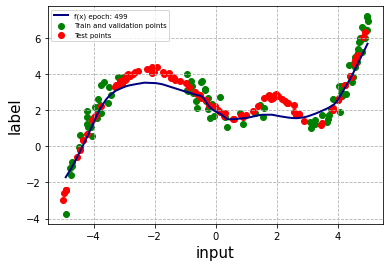

In [ ]:
N_epochs = 500
train_loss_log, val_loss_log, best = fit(net, train_dataloader, val_dataloader, epochs=N_epochs, lr=1e-3, weight_decay=1e-5, 
                                   optimizer_function=optim.Adam, loss_function=nn.MSELoss, sparsity=True, reg_param=0.001, verbose=1);

print(f'Best epoch: %0.0f, best loss: %0.3f' %(best[0], best[1]))

In [ ]:
test_loss = evaluate(net, test_dataloader)
print(f"FINAL TEST LOSS: {test_loss}")

FINAL TEST LOSS: [array(0.3381243, dtype=float32)]


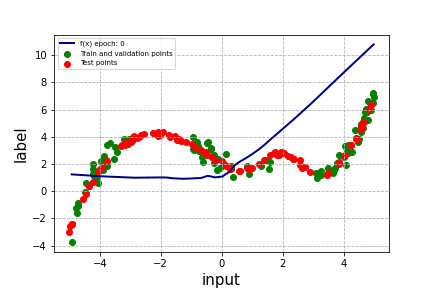

In [ ]:
# Build GIF
with imageio.get_writer('mygif.gif', mode='I') as writer:
    for filename in range(N_epochs):
        image = imageio.imread(str(filename)+'.png')
        writer.append_data(image)

ip.display.Image(open('/content/mygif.gif', 'rb').read())

In [ ]:
### To reload the best network parameters ###

#net = Net(Ni, Nh1, Nh2, No, p) 
# Load the state dict previously saved
#net_state_dict = torch.load('net_best_parameters.torch')
# Update the network parameters
#net.load_state_dict(net_state_dict)

Looking at the plot, we can notice that the training is done quite well except for a small region where the training data are not defined, as we already mentioned. In fact, the performances are good and the inferred function fit properly the curve. The GIF shows us also another important thing: in the first epochs the function change rapidly to fit better all the data, but at a certain point the variations are very small and it is changed one region at time accordingly with the samples.

## Network analysis

In [ ]:
### Weights histogram
def weights_histogram(net, layers):

  w = []
  b = []
  for l in layers:
    w.append(l.weight.data.cpu().numpy())
    b.append(l.bias.data.cpu().numpy())

  r = len(layers)
  fig, axs = plt.subplots(r, 1, figsize=(16,r*4))
  for n in range(r):
    axs[n].hist(w[n].flatten(), 50, color='green')
    axs[n].set_title('Layer weights', fontsize=20)

  [ax.grid(linestyle='--') for ax in axs]
  plt.tight_layout()
  plt.show()


# Using Hook to analyse one layer activations
def get_activation(layer, input, output):
    global activation
    activation = torch.sigmoid(output)

### activation of a specific layer for a given input
def analyse_activation(net, layer, data): 

  ### Register hook of selected layer
  hook_handle = layer.register_forward_hook(get_activation)

  ### Analyze activations
  net = net.to(device)
  net.eval()
  x = []
  z = []
  with torch.no_grad():
    for d in data:
      x.append(torch.tensor([d]).float().to(device))
      y = net(x[-1].unsqueeze(0))
      z.append(activation)

  ### Remove hook
  hook_handle.remove()

  ### Plot activations
  r = len(z)
  fig, axs = plt.subplots(r, 1, figsize=(14, r*2))
  for n in range(r):
      axs[n].stem(z[n].squeeze().cpu().numpy(), use_line_collection=True)
      axs[n].set_title('Chosen layer activation for input x=%.2f' % x[n], fontsize=20)
  plt.tight_layout()
  plt.show()

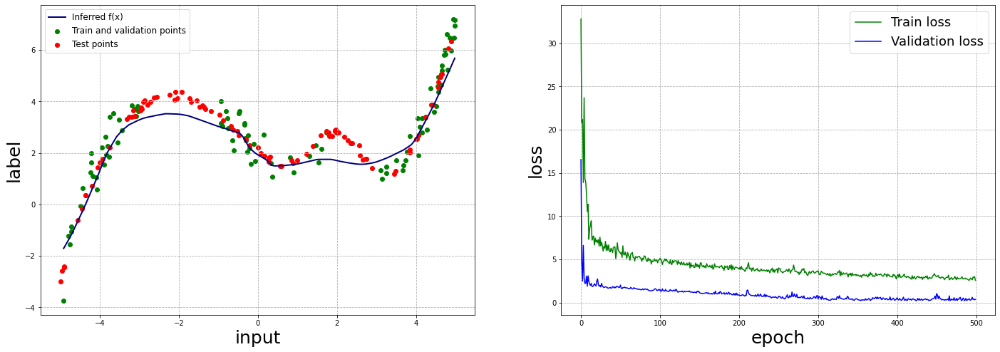

In [ ]:
# Network final output
x_vec = torch.linspace(np.min(train_df.input),np.max(train_df.input),1000)
x_vec = x_vec.to(device)
x_vec = x_vec.unsqueeze(-1)

net.eval()
with torch.no_grad(): 
    y_vec = net(x_vec)
x_vec = x_vec.squeeze().cpu().numpy()
y_vec = y_vec.squeeze().cpu().numpy()


# Plot losses
fig, (ax, bx) = plt.subplots(1,2,figsize=(24,8))

ax.scatter(train_df.input, train_df.label, color='green', label='Train and validation points')
ax.scatter(test_df.input, test_df.label, color='red', label='Test points')
ax.plot(x_vec, y_vec, color='navy', label='Inferred f(x)', linewidth=2)
ax.set_xlabel('input', fontsize=25)
ax.set_ylabel('label', fontsize=25)
ax.grid(linestyle='--')
ax.legend(fontsize=12)

bx.plot(train_loss_log, label='Train loss', color='green')
bx.plot(val_loss_log, label='Validation loss', color='blue')
bx.set_xlabel('epoch', fontsize=25)
bx.set_ylabel('loss', fontsize=25)
bx.grid(linestyle='--')
bx.legend(fontsize=18);

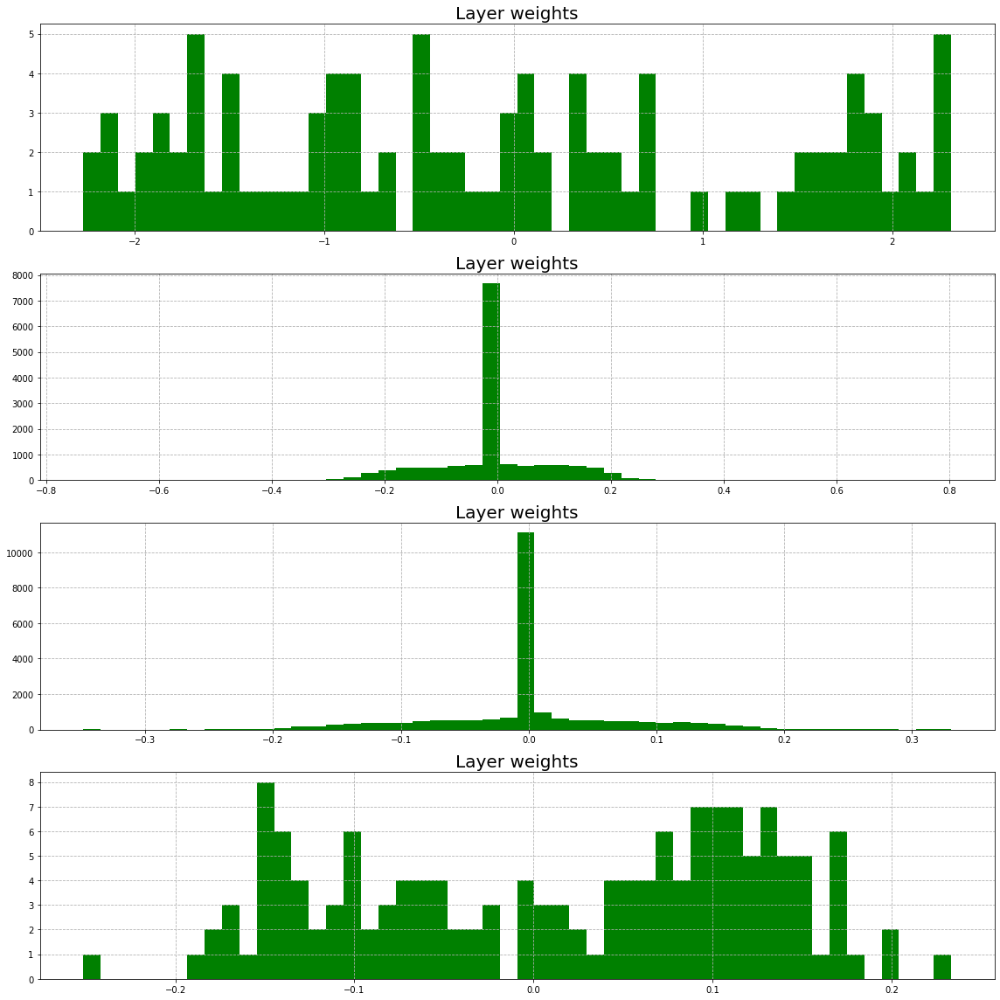

In [ ]:
weights_histogram(net, [net.fc1, net.fc2, net.fc3, net.out])

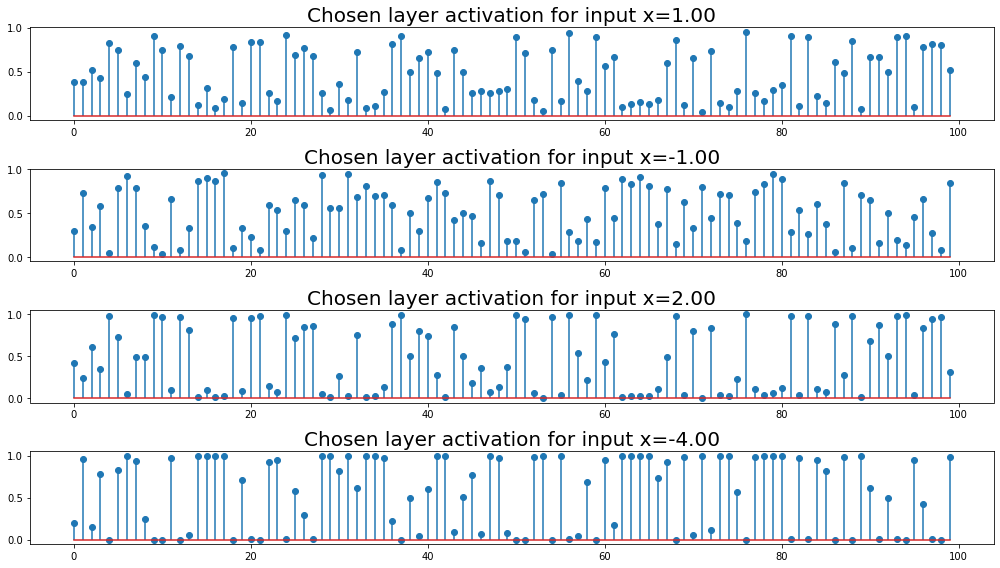

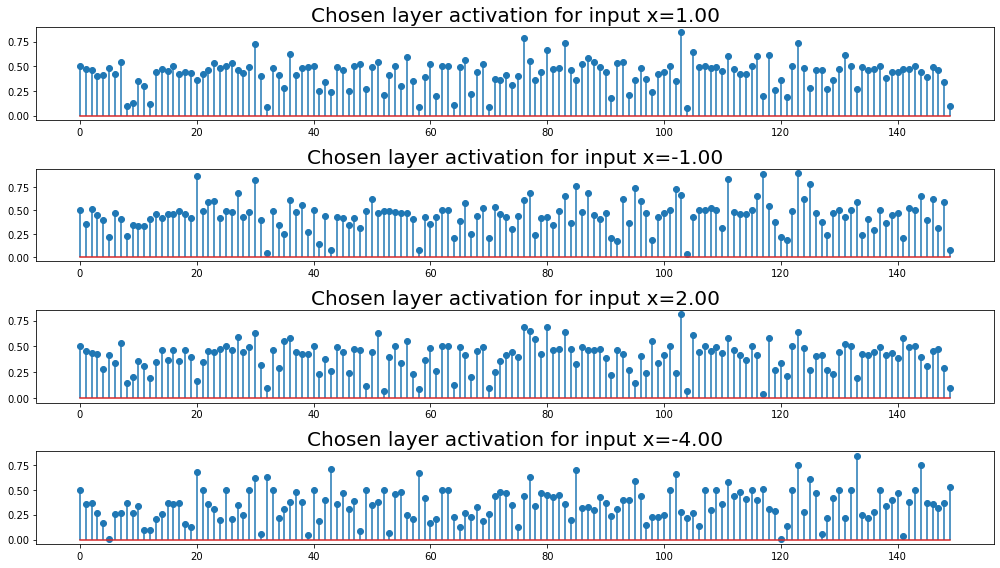

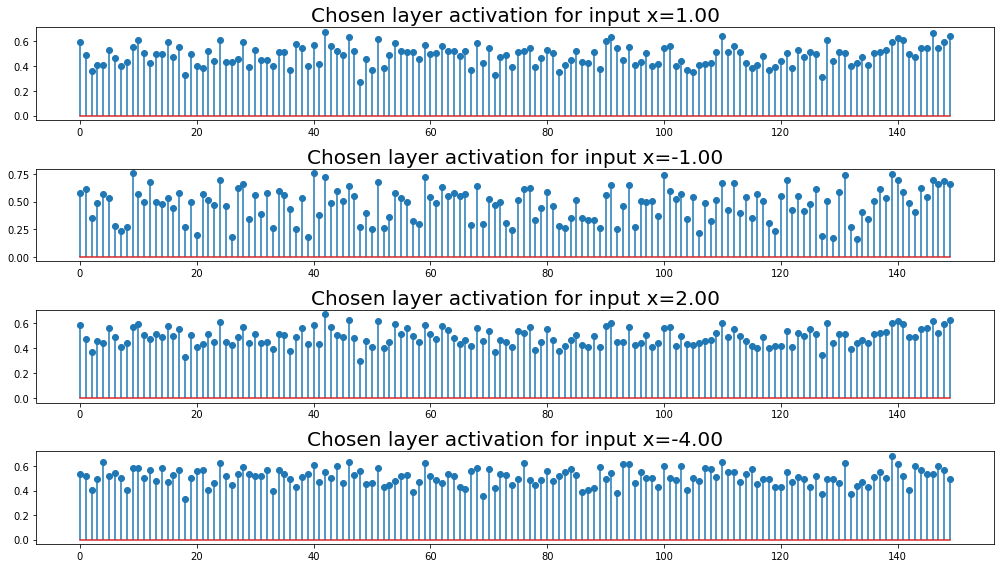

In [ ]:
data = [1, -1, 2, -4]
analyse_activation(net, net.fc1, data)
analyse_activation(net, net.fc2, data)
analyse_activation(net, net.fc3, data)

## Find the best parameters

### Manual Hyper-parameters Tuning

In [ ]:
torch.manual_seed(seed)

Nh1_list = [60, 80, 100, 120]
Nh2_list = [120, 180, 200]
p_list = [0.0, 0.2, 0.4]
lr_list = [1e-3, 1e-2]
weight_decay_list = [1e-5] #, 1e-4]
optimizer_list = [optim.Adam] #, optim.RMSprop]
batch_size_list = [10,50]
reg_param_list = [1e-4, 1e-3, 1e-2]
epoch = 500

best_list = {} #{'Nh1' : 0, 'Nh2' : 0, 'p' : 0, 'lr': 0, 'weight_decay': 0, 'opt' : optim.Adam, 'batch_size' : 0}
best_loss = 1000

for n1 in tqdm(Nh1_list): 
  for n2 in Nh2_list:
    for p in p_list:
      for lr in lr_list:
        for weight_decay in weight_decay_list:
          for opt in optimizer_list:
            for batch_size in batch_size_list:
              for reg_param in reg_param_list:
              
                num_workers = 0
                train_dataloader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers)
                val_dataloader  = DataLoader(val, batch_size=len(val), shuffle=False, num_workers=num_workers)
                test_dataloader  = DataLoader(test_dataset,  batch_size=len(test_dataset), shuffle=False, num_workers=num_workers)

                Ni = 1
                No = 1
                net = Net(Ni, n1, n2, No, p)
                net.to(device)

                train_loss_log, val_loss_log, best = fit(net, train_dataloader, val_dataloader, epochs=epoch, lr=lr, weight_decay=weight_decay,
                                            optimizer_function=optim.Adam, loss_function=nn.MSELoss, sparsity=True, reg_param=reg_param)
                
                print(f'Current trial loss: %0.3f | Best loss: %0.3f ' %(val_loss_log[-1], best_loss))

                # save best loss
                if val_loss_log[-1] < best_loss:
                  best_loss = val_loss_log[-1]
                  best_list['Nh1'] = n1
                  best_list['Nh2'] = n2
                  best_list['p'] = p
                  best_list['lr'] = lr
                  best_list['weight_decay'] = weight_decay
                  best_list['opt'] = opt
                  best_list['batch_size'] = batch_size
                  best_list['reg_param'] = reg_param

print('Best loss:', best_loss)
print('Best parameters:', best_list)

  0%|          | 0/4 [00:00<?, ?it/s]

Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.161 | Best loss: 1000.000 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.186 | Best loss: 0.161 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.724 | Best loss: 0.161 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.167 | Best loss: 0.161 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.176 | Best loss: 0.161 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.114 | Best loss: 0.161 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.159 | Best loss: 0.161 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.230 | Best loss: 0.159 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.184 | Best loss: 0.159 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.302 | Best loss: 0.159 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.164 | Best loss: 0.159 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.269 | Best loss: 0.159 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.150 | Best loss: 0.159 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.310 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.057 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.163 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.190 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.351 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.317 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.296 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.522 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.188 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.247 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.470 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.271 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.358 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.579 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.221 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.201 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.393 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.352 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.309 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.056 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.335 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.276 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.844 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.188 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.142 | Best loss: 0.150 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.274 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.169 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.196 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.216 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.156 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.183 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.236 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.202 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.159 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.267 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.200 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.251 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.477 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.193 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.295 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.141 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.307 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.407 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.511 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.222 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.252 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.538 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.227 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.338 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.710 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.206 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.295 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.170 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.538 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.489 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.660 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.296 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.287 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.597 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.226 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.140 | Best loss: 0.142 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.526 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.219 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.165 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.070 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.491 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.224 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.251 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.270 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.166 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.195 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.146 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.234 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.477 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.199 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.208 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.917 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.547 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.654 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.516 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.250 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.247 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.419 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.231 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.338 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.983 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.161 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.284 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.316 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.391 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.288 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.741 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.309 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.254 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.966 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.195 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.139 | Best loss: 0.140 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.490 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.184 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.171 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.990 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.182 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.337 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.667 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.387 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.157 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.185 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.652 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.282 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.424 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.221 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.289 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 1.472 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.590 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.259 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.512 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.317 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.235 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.515 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.343 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

Current trial loss: 0.299 | Best loss: 0.139 
Network initialized


  0%|          | 0/500 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

### Automatic Hyper-parameters Tuning: Optuna

In [ ]:
def objective(trial):

    # hyperparameters to optimize
    hyper_parameters=[
        trial.suggest_discrete_uniform("p", 0.0, 0.4, 0.05),
        trial.suggest_discrete_uniform("lr", 0.0005, 0.01, 0.0005),
        trial.suggest_categorical("weight_decay", [5e-5, 1e-4, 5e-4, 1e-3]),
        trial.suggest_int("Nh1", 64, 256, log=True),
        trial.suggest_int("Nh2", 64, 256, log=True),
        trial.suggest_categorical("optimizer", [optim.SGD, optim.Adam, optim.RMSprop]),
    ]

    ###########################################################################################################

    model = Net(Ni, hyper_parameters[3], hyper_parameters[4], No, p=hyper_parameters[0])
    model.to(device)

    train_loss_log, val_loss_log, best = fit(net, train_dataloader, val_dataloader, epochs=300, lr=hyper_parameters[1], weight_decay=hyper_parameters[2],
                                   optimizer_function=hyper_parameters[5], loss_function=nn.MSELoss)

    return val_loss_log[-1]


study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=100)

pruned_trials = [t for t in study.trials if t.state == optuna.structs.TrialState.PRUNED]
complete_trials = [t for t in study.trials if t.state == optuna.structs.TrialState.COMPLETE]

print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
  print("    {}: {}".format(key, value))

[I 2021-12-23 18:31:54,108] A new study created in memory with name: no-name-41000c88-f1c5-4f46-a640-122ac51c1410


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:31:56,672] Trial 0 finished with value: 0.260586142539978 and parameters: {'p': 0.30000000000000004, 'lr': 0.0085, 'weight_decay': 0.0001, 'Nh1': 166, 'Nh2': 249, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:31:59,301] Trial 1 finished with value: 0.4989822506904602 and parameters: {'p': 0.35000000000000003, 'lr': 0.004, 'weight_decay': 0.0001, 'Nh1': 228, 'Nh2': 203, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:01,434] Trial 2 finished with value: 1.635733962059021 and parameters: {'p': 0.30000000000000004, 'lr': 0.009000000000000001, 'weight_decay': 0.001, 'Nh1': 98, 'Nh2': 111, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:03,508] Trial 3 finished with value: 0.31235000491142273 and parameters: {'p': 0.35000000000000003, 'lr': 0.009000000000000001, 'weight_decay': 5e-05, 'Nh1': 135, 'Nh2': 129, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:06,107] Trial 4 finished with value: 0.348434180021286 and parameters: {'p': 0.05, 'lr': 0.004, 'weight_decay': 0.0001, 'Nh1': 87, 'Nh2': 154, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:08,169] Trial 5 finished with value: 0.30913668870925903 and parameters: {'p': 0.4, 'lr': 0.001, 'weight_decay': 0.0005, 'Nh1': 151, 'Nh2': 178, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:10,272] Trial 6 finished with value: 0.31113362312316895 and parameters: {'p': 0.1, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 97, 'Nh2': 203, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:12,340] Trial 7 finished with value: 0.3417130708694458 and parameters: {'p': 0.1, 'lr': 0.006500000000000001, 'weight_decay': 0.0001, 'Nh1': 67, 'Nh2': 128, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:14,447] Trial 8 finished with value: 0.29673275351524353 and parameters: {'p': 0.1, 'lr': 0.001, 'weight_decay': 0.0001, 'Nh1': 91, 'Nh2': 193, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:16,920] Trial 9 finished with value: 0.3824159801006317 and parameters: {'p': 0.30000000000000004, 'lr': 0.004, 'weight_decay': 0.0005, 'Nh1': 126, 'Nh2': 229, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:19,459] Trial 10 finished with value: 0.6236333847045898 and parameters: {'p': 0.2, 'lr': 0.007000000000000001, 'weight_decay': 0.001, 'Nh1': 224, 'Nh2': 72, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:21,974] Trial 11 finished with value: 0.7401037812232971 and parameters: {'p': 0.2, 'lr': 0.01, 'weight_decay': 0.0001, 'Nh1': 171, 'Nh2': 253, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 0 with value: 0.260586142539978.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:24,492] Trial 12 finished with value: 0.25601667165756226 and parameters: {'p': 0.0, 'lr': 0.002, 'weight_decay': 0.0001, 'Nh1': 71, 'Nh2': 165, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:26,899] Trial 13 finished with value: 0.5008036494255066 and parameters: {'p': 0.0, 'lr': 0.0025, 'weight_decay': 5e-05, 'Nh1': 70, 'Nh2': 91, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:29,483] Trial 14 finished with value: 0.4421563148498535 and parameters: {'p': 0.25, 'lr': 0.006500000000000001, 'weight_decay': 0.0001, 'Nh1': 182, 'Nh2': 159, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:31,920] Trial 15 finished with value: 0.48011502623558044 and parameters: {'p': 0.15000000000000002, 'lr': 0.0025, 'weight_decay': 0.0001, 'Nh1': 116, 'Nh2': 251, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:34,385] Trial 16 finished with value: 0.5942330360412598 and parameters: {'p': 0.0, 'lr': 0.008, 'weight_decay': 0.0001, 'Nh1': 181, 'Nh2': 155, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:37,081] Trial 17 finished with value: 0.3140984773635864 and parameters: {'p': 0.25, 'lr': 0.005000000000000001, 'weight_decay': 5e-05, 'Nh1': 256, 'Nh2': 105, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:39,541] Trial 18 finished with value: 0.3606029450893402 and parameters: {'p': 0.4, 'lr': 0.002, 'weight_decay': 0.001, 'Nh1': 78, 'Nh2': 222, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:42,121] Trial 19 finished with value: 0.898099422454834 and parameters: {'p': 0.15000000000000002, 'lr': 0.008, 'weight_decay': 0.0001, 'Nh1': 115, 'Nh2': 173, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:44,675] Trial 20 finished with value: 0.5441401600837708 and parameters: {'p': 0.25, 'lr': 0.005000000000000001, 'weight_decay': 0.0001, 'Nh1': 150, 'Nh2': 138, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:46,769] Trial 21 finished with value: 0.4813270568847656 and parameters: {'p': 0.05, 'lr': 0.0015, 'weight_decay': 0.0001, 'Nh1': 78, 'Nh2': 194, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:48,918] Trial 22 finished with value: 0.9854819178581238 and parameters: {'p': 0.05, 'lr': 0.003, 'weight_decay': 0.0001, 'Nh1': 99, 'Nh2': 219, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:51,806] Trial 23 finished with value: 0.4628596007823944 and parameters: {'p': 0.1, 'lr': 0.0005, 'weight_decay': 0.0001, 'Nh1': 79, 'Nh2': 181, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:54,308] Trial 24 finished with value: 0.37221071124076843 and parameters: {'p': 0.0, 'lr': 0.0015, 'weight_decay': 0.0001, 'Nh1': 64, 'Nh2': 233, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:56,550] Trial 25 finished with value: 0.8318883180618286 and parameters: {'p': 0.15000000000000002, 'lr': 0.0035, 'weight_decay': 0.0001, 'Nh1': 88, 'Nh2': 143, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:32:59,085] Trial 26 finished with value: 0.4303812086582184 and parameters: {'p': 0.05, 'lr': 0.0055, 'weight_decay': 5e-05, 'Nh1': 111, 'Nh2': 192, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:01,248] Trial 27 finished with value: 0.5407623648643494 and parameters: {'p': 0.1, 'lr': 0.0015, 'weight_decay': 0.001, 'Nh1': 73, 'Nh2': 114, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:03,816] Trial 28 finished with value: 0.9668377041816711 and parameters: {'p': 0.30000000000000004, 'lr': 0.01, 'weight_decay': 0.0005, 'Nh1': 158, 'Nh2': 168, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:06,565] Trial 29 finished with value: 0.3298095166683197 and parameters: {'p': 0.35000000000000003, 'lr': 0.0045000000000000005, 'weight_decay': 0.0001, 'Nh1': 205, 'Nh2': 208, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:09,294] Trial 30 finished with value: 0.45309171080589294 and parameters: {'p': 0.0, 'lr': 0.003, 'weight_decay': 0.0001, 'Nh1': 136, 'Nh2': 66, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:11,507] Trial 31 finished with value: 0.3273954391479492 and parameters: {'p': 0.4, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 149, 'Nh2': 182, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:13,681] Trial 32 finished with value: 0.4039665162563324 and parameters: {'p': 0.35000000000000003, 'lr': 0.001, 'weight_decay': 0.0005, 'Nh1': 166, 'Nh2': 168, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:15,861] Trial 33 finished with value: 0.2952658236026764 and parameters: {'p': 0.4, 'lr': 0.001, 'weight_decay': 0.0005, 'Nh1': 140, 'Nh2': 143, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:18,051] Trial 34 finished with value: 0.2950083911418915 and parameters: {'p': 0.35000000000000003, 'lr': 0.002, 'weight_decay': 0.0005, 'Nh1': 133, 'Nh2': 143, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:20,226] Trial 35 finished with value: 0.36143335700035095 and parameters: {'p': 0.35000000000000003, 'lr': 0.002, 'weight_decay': 0.0005, 'Nh1': 134, 'Nh2': 111, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:22,433] Trial 36 finished with value: 0.4199918210506439 and parameters: {'p': 0.30000000000000004, 'lr': 0.003, 'weight_decay': 0.0005, 'Nh1': 126, 'Nh2': 139, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:24,646] Trial 37 finished with value: 0.8314905166625977 and parameters: {'p': 0.4, 'lr': 0.008, 'weight_decay': 0.0005, 'Nh1': 139, 'Nh2': 123, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:26,894] Trial 38 finished with value: 0.35130587220191956 and parameters: {'p': 0.35000000000000003, 'lr': 0.002, 'weight_decay': 0.0005, 'Nh1': 195, 'Nh2': 97, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:29,680] Trial 39 finished with value: 0.29118260741233826 and parameters: {'p': 0.4, 'lr': 0.006, 'weight_decay': 0.0005, 'Nh1': 109, 'Nh2': 121, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:32,479] Trial 40 finished with value: 0.4920119345188141 and parameters: {'p': 0.35000000000000003, 'lr': 0.009000000000000001, 'weight_decay': 0.001, 'Nh1': 106, 'Nh2': 118, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:35,185] Trial 41 finished with value: 0.42967310547828674 and parameters: {'p': 0.4, 'lr': 0.006, 'weight_decay': 0.0005, 'Nh1': 124, 'Nh2': 145, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:37,971] Trial 42 finished with value: 0.36441487073898315 and parameters: {'p': 0.4, 'lr': 0.0075, 'weight_decay': 0.0005, 'Nh1': 146, 'Nh2': 130, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:40,761] Trial 43 finished with value: 0.3266599178314209 and parameters: {'p': 0.30000000000000004, 'lr': 0.009000000000000001, 'weight_decay': 0.0005, 'Nh1': 99, 'Nh2': 103, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:43,296] Trial 44 finished with value: 0.3960859477519989 and parameters: {'p': 0.30000000000000004, 'lr': 0.0035, 'weight_decay': 0.0005, 'Nh1': 166, 'Nh2': 153, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:45,603] Trial 45 finished with value: 1.7619117498397827 and parameters: {'p': 0.35000000000000003, 'lr': 0.006, 'weight_decay': 0.0005, 'Nh1': 120, 'Nh2': 88, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:48,232] Trial 46 finished with value: 0.37251004576683044 and parameters: {'p': 0.4, 'lr': 0.0045000000000000005, 'weight_decay': 5e-05, 'Nh1': 108, 'Nh2': 131, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:51,067] Trial 47 finished with value: 0.3535713255405426 and parameters: {'p': 0.35000000000000003, 'lr': 0.009500000000000001, 'weight_decay': 0.0005, 'Nh1': 158, 'Nh2': 122, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:53,681] Trial 48 finished with value: 0.9821958541870117 and parameters: {'p': 0.25, 'lr': 0.007000000000000001, 'weight_decay': 0.0005, 'Nh1': 184, 'Nh2': 84, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:55,942] Trial 49 finished with value: 0.884295642375946 and parameters: {'p': 0.4, 'lr': 0.001, 'weight_decay': 0.001, 'Nh1': 93, 'Nh2': 159, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:33:58,513] Trial 50 finished with value: 0.4805200695991516 and parameters: {'p': 0.30000000000000004, 'lr': 0.0025, 'weight_decay': 5e-05, 'Nh1': 140, 'Nh2': 148, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:00,725] Trial 51 finished with value: 0.5716874003410339 and parameters: {'p': 0.1, 'lr': 0.0015, 'weight_decay': 0.0001, 'Nh1': 84, 'Nh2': 244, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:02,969] Trial 52 finished with value: 0.6178906559944153 and parameters: {'p': 0.2, 'lr': 0.0005, 'weight_decay': 0.0001, 'Nh1': 94, 'Nh2': 135, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:05,155] Trial 53 finished with value: 0.591694176197052 and parameters: {'p': 0.05, 'lr': 0.001, 'weight_decay': 0.0001, 'Nh1': 103, 'Nh2': 207, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:07,423] Trial 54 finished with value: 0.641425609588623 and parameters: {'p': 0.2, 'lr': 0.002, 'weight_decay': 0.0001, 'Nh1': 70, 'Nh2': 193, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:10,020] Trial 55 finished with value: 0.4447445571422577 and parameters: {'p': 0.15000000000000002, 'lr': 0.0025, 'weight_decay': 0.0001, 'Nh1': 132, 'Nh2': 163, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:12,282] Trial 56 finished with value: 0.6207002997398376 and parameters: {'p': 0.4, 'lr': 0.001, 'weight_decay': 0.0005, 'Nh1': 85, 'Nh2': 180, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:14,943] Trial 57 finished with value: 0.503986120223999 and parameters: {'p': 0.35000000000000003, 'lr': 0.0085, 'weight_decay': 0.0001, 'Nh1': 120, 'Nh2': 150, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:17,834] Trial 58 finished with value: 0.36109328269958496 and parameters: {'p': 0.15000000000000002, 'lr': 0.0035, 'weight_decay': 0.0001, 'Nh1': 74, 'Nh2': 214, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:20,163] Trial 59 finished with value: 0.5256974697113037 and parameters: {'p': 0.0, 'lr': 0.0015, 'weight_decay': 0.001, 'Nh1': 116, 'Nh2': 243, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:22,875] Trial 60 finished with value: 0.4719139039516449 and parameters: {'p': 0.05, 'lr': 0.007000000000000001, 'weight_decay': 5e-05, 'Nh1': 64, 'Nh2': 190, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:25,142] Trial 61 finished with value: 0.5393527150154114 and parameters: {'p': 0.4, 'lr': 0.001, 'weight_decay': 0.0005, 'Nh1': 144, 'Nh2': 172, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:27,370] Trial 62 finished with value: 0.45620855689048767 and parameters: {'p': 0.4, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 155, 'Nh2': 159, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:29,654] Trial 63 finished with value: 0.5403837561607361 and parameters: {'p': 0.35000000000000003, 'lr': 0.002, 'weight_decay': 0.0005, 'Nh1': 177, 'Nh2': 232, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:31,944] Trial 64 finished with value: 0.8635549545288086 and parameters: {'p': 0.4, 'lr': 0.0015, 'weight_decay': 0.0005, 'Nh1': 130, 'Nh2': 178, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:34,195] Trial 65 finished with value: 0.4116564393043518 and parameters: {'p': 0.1, 'lr': 0.0005, 'weight_decay': 0.0001, 'Nh1': 81, 'Nh2': 199, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:36,861] Trial 66 finished with value: 0.4574964642524719 and parameters: {'p': 0.35000000000000003, 'lr': 0.0025, 'weight_decay': 0.0005, 'Nh1': 152, 'Nh2': 140, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:39,740] Trial 67 finished with value: 0.3461625576019287 and parameters: {'p': 0.4, 'lr': 0.001, 'weight_decay': 0.0001, 'Nh1': 91, 'Nh2': 123, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:42,145] Trial 68 finished with value: 0.37333008646965027 and parameters: {'p': 0.25, 'lr': 0.0055, 'weight_decay': 0.0005, 'Nh1': 166, 'Nh2': 165, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:44,951] Trial 69 finished with value: 0.374973326921463 and parameters: {'p': 0.35000000000000003, 'lr': 0.004, 'weight_decay': 0.0001, 'Nh1': 215, 'Nh2': 135, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:47,353] Trial 70 finished with value: 0.3430245518684387 and parameters: {'p': 0.1, 'lr': 0.0015, 'weight_decay': 0.0005, 'Nh1': 250, 'Nh2': 222, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:49,707] Trial 71 finished with value: 0.3080238103866577 and parameters: {'p': 0.2, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 102, 'Nh2': 174, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:52,044] Trial 72 finished with value: 0.3074568212032318 and parameters: {'p': 0.05, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 104, 'Nh2': 174, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:54,337] Trial 73 finished with value: 0.3018762767314911 and parameters: {'p': 0.0, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 104, 'Nh2': 188, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:56,662] Trial 74 finished with value: 0.319578617811203 and parameters: {'p': 0.0, 'lr': 0.001, 'weight_decay': 0.0005, 'Nh1': 112, 'Nh2': 186, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:34:58,944] Trial 75 finished with value: 0.2959155738353729 and parameters: {'p': 0.05, 'lr': 0.0005, 'weight_decay': 0.0005, 'Nh1': 97, 'Nh2': 156, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:01,179] Trial 76 finished with value: 0.30944767594337463 and parameters: {'p': 0.0, 'lr': 0.0015, 'weight_decay': 0.0005, 'Nh1': 111, 'Nh2': 155, 'optimizer': <class 'torch.optim.sgd.SGD'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:04,097] Trial 77 finished with value: 0.2903468608856201 and parameters: {'p': 0.0, 'lr': 0.002, 'weight_decay': 0.001, 'Nh1': 96, 'Nh2': 145, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:07,056] Trial 78 finished with value: 0.3012999892234802 and parameters: {'p': 0.05, 'lr': 0.003, 'weight_decay': 0.001, 'Nh1': 97, 'Nh2': 144, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:09,997] Trial 79 finished with value: 0.34139782190322876 and parameters: {'p': 0.05, 'lr': 0.002, 'weight_decay': 0.001, 'Nh1': 87, 'Nh2': 132, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:12,888] Trial 80 finished with value: 0.29612404108047485 and parameters: {'p': 0.0, 'lr': 0.006500000000000001, 'weight_decay': 0.001, 'Nh1': 90, 'Nh2': 114, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:15,768] Trial 81 finished with value: 0.317747563123703 and parameters: {'p': 0.0, 'lr': 0.006500000000000001, 'weight_decay': 0.001, 'Nh1': 90, 'Nh2': 106, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:18,699] Trial 82 finished with value: 0.4569628834724426 and parameters: {'p': 0.0, 'lr': 0.006, 'weight_decay': 0.001, 'Nh1': 81, 'Nh2': 117, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:21,654] Trial 83 finished with value: 0.26984044909477234 and parameters: {'p': 0.05, 'lr': 0.0075, 'weight_decay': 0.001, 'Nh1': 74, 'Nh2': 128, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:24,611] Trial 84 finished with value: 0.30005061626434326 and parameters: {'p': 0.0, 'lr': 0.0085, 'weight_decay': 0.001, 'Nh1': 75, 'Nh2': 127, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:27,563] Trial 85 finished with value: 0.3167836368083954 and parameters: {'p': 0.05, 'lr': 0.0075, 'weight_decay': 0.001, 'Nh1': 66, 'Nh2': 109, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:30,535] Trial 86 finished with value: 0.35597625374794006 and parameters: {'p': 0.0, 'lr': 0.006500000000000001, 'weight_decay': 0.001, 'Nh1': 96, 'Nh2': 127, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:33,555] Trial 87 finished with value: 0.2750066816806793 and parameters: {'p': 0.05, 'lr': 0.0075, 'weight_decay': 0.001, 'Nh1': 100, 'Nh2': 98, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:36,482] Trial 88 finished with value: 0.40316829085350037 and parameters: {'p': 0.05, 'lr': 0.0075, 'weight_decay': 0.001, 'Nh1': 70, 'Nh2': 99, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:39,498] Trial 89 finished with value: 0.3020162582397461 and parameters: {'p': 0.05, 'lr': 0.0085, 'weight_decay': 0.001, 'Nh1': 119, 'Nh2': 84, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:42,441] Trial 90 finished with value: 0.4859618842601776 and parameters: {'p': 0.1, 'lr': 0.009500000000000001, 'weight_decay': 0.001, 'Nh1': 100, 'Nh2': 148, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:45,409] Trial 91 finished with value: 0.3569669723510742 and parameters: {'p': 0.0, 'lr': 0.007000000000000001, 'weight_decay': 0.001, 'Nh1': 94, 'Nh2': 114, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:48,375] Trial 92 finished with value: 0.48822328448295593 and parameters: {'p': 0.05, 'lr': 0.0075, 'weight_decay': 0.001, 'Nh1': 108, 'Nh2': 94, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:51,333] Trial 93 finished with value: 0.3514162003993988 and parameters: {'p': 0.0, 'lr': 0.0055, 'weight_decay': 0.001, 'Nh1': 72, 'Nh2': 119, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:54,324] Trial 94 finished with value: 0.3001192808151245 and parameters: {'p': 0.0, 'lr': 0.008, 'weight_decay': 0.001, 'Nh1': 124, 'Nh2': 139, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:35:57,258] Trial 95 finished with value: 0.3856447637081146 and parameters: {'p': 0.05, 'lr': 0.005000000000000001, 'weight_decay': 5e-05, 'Nh1': 88, 'Nh2': 73, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:36:00,061] Trial 96 finished with value: 0.5019842386245728 and parameters: {'p': 0.0, 'lr': 0.006, 'weight_decay': 0.001, 'Nh1': 139, 'Nh2': 124, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:36:03,045] Trial 97 finished with value: 0.3107655942440033 and parameters: {'p': 0.30000000000000004, 'lr': 0.007000000000000001, 'weight_decay': 0.001, 'Nh1': 83, 'Nh2': 134, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:36:06,034] Trial 98 finished with value: 0.3322819173336029 and parameters: {'p': 0.1, 'lr': 0.006500000000000001, 'weight_decay': 0.001, 'Nh1': 100, 'Nh2': 153, 'optimizer': <class 'torch.optim.adam.Adam'>}. Best is trial 12 with value: 0.25601667165756226.


Network initialized


/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.sgd.SGD'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.adam.Adam'> which is of type type.

/usr/local/lib/python3.7/dist-packages/optuna/distributions.py:427: UserWarning:

Choices for a categorical distribution should be a tuple of None, bool, int, float and str for persistent storage but contains <class 'torch.optim.rmsprop.RMSprop'> which is of type type.



  0%|          | 0/300 [00:00<?, ?it/s]

[I 2021-12-23 18:36:08,830] Trial 99 finished with value: 0.6781665682792664 and parameters: {'p': 0.4, 'lr': 0.008, 'weight_decay': 0.001, 'Nh1': 79, 'Nh2': 112, 'optimizer': <class 'torch.optim.rmsprop.RMSprop'>}. Best is trial 12 with value: 0.25601667165756226.


Study statistics: 
  Number of finished trials:  100
  Number of pruned trials:  0
  Number of complete trials:  100
Best trial:
  Value:  0.25601667165756226
  Params: 
    p: 0.0
    lr: 0.002
    weight_decay: 0.0001
    Nh1: 71
    Nh2: 165
    optimizer: <class 'torch.optim.rmsprop.RMSprop'>


/usr/local/lib/python3.7/dist-packages/optuna/structs.py:18: FutureWarning:

`structs` is deprecated. Classes have moved to the following modules. `structs.StudyDirection`->`study.StudyDirection`, `structs.StudySummary`->`study.StudySummary`, `structs.FrozenTrial`->`trial.FrozenTrial`, `structs.TrialState`->`trial.TrialState`, `structs.TrialPruned`->`exceptions.TrialPruned`.



## K-fold cross validation

In [ ]:
#best_list = {'Nh1': 80, 'Nh2': 200, 'p': 0.0, 'lr': 0.001, 'weight_decay': 1e-05, 'opt': optim.Adam, 'batch_size': 50, 'reg_param': 0.001}

In [ ]:
epochs= 5000
k_folds = 5
results = {}
kfold = KFold(n_splits=k_folds, shuffle=True)
    
# Start print
print('--------------------------------')

# K-fold Cross Validation model evaluation
for fold, (train_ids, test_ids) in enumerate(kfold.split(train_dataset)):
    
    # Print
    print(f'FOLD {fold+1}')
    print('--------------------------------')
    
    # Sample elements randomly from a given list of ids, no replacement.
    train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
    test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)
    
    # Define data loaders for training and testing data in this fold
    train_dataloader = torch.utils.data.DataLoader(
                      train_dataset, 
                      batch_size=best_list['batch_size'], sampler=train_subsampler)
    test_dataloader = torch.utils.data.DataLoader(
                      train_dataset,
                      batch_size=best_list['batch_size'], sampler=test_subsampler)
    
    # Init the neural network
    net = Net(Ni, best_list['Nh1'], best_list['Nh2'], No, p=best_list['p'])
    net.to(device)

    train_loss_log, val_loss_log, best = fit(net, train_dataloader, test_dataloader, epochs=epochs, lr=best_list['lr'], weight_decay=best_list['weight_decay'],
                                   optimizer_function=best_list['opt'], loss_function=nn.MSELoss, sparsity= True, reg_param= best_list['reg_param'])

    
    # Saving the model
    save_path = f'./model-fold-{fold}.pth'
    torch.save(net.state_dict(), save_path)

    # Print loss
    print(f'Loss for fold %0.0f: %0.3f' % (fold+1, val_loss_log[-1]))
    print('--------------------------------')
    results[fold] = val_loss_log[-1]
    
# Print fold results
print(f'K-FOLD CROSS VALIDATION RESULTS FOR {k_folds} FOLDS')
print('--------------------------------')
sum = 0.0
for key, value in results.items():
  print(f'Fold {key}: {value}')
  sum += value
print(f'Average: {sum/len(results.items())}')

--------------------------------
FOLD 1
--------------------------------
Network initialized


  0%|          | 0/5000 [00:00<?, ?it/s]

Loss for fold 1: 0.316
--------------------------------
FOLD 2
--------------------------------
Network initialized


  0%|          | 0/5000 [00:00<?, ?it/s]

Loss for fold 2: 0.546
--------------------------------
FOLD 3
--------------------------------
Network initialized


  0%|          | 0/5000 [00:00<?, ?it/s]

Loss for fold 3: 0.207
--------------------------------
FOLD 4
--------------------------------
Network initialized


  0%|          | 0/5000 [00:00<?, ?it/s]

Loss for fold 4: 0.308
--------------------------------
FOLD 5
--------------------------------
Network initialized


  0%|          | 0/5000 [00:00<?, ?it/s]

Loss for fold 5: 0.359
--------------------------------
K-FOLD CROSS VALIDATION RESULTS FOR 5 FOLDS
--------------------------------
Fold 0: 0.3160552978515625
Fold 1: 0.5457714200019836
Fold 2: 0.20679502189159393
Fold 3: 0.3075326085090637
Fold 4: 0.35857754945755005
Average: 0.34694637954235075


#### Network analysis of last fold

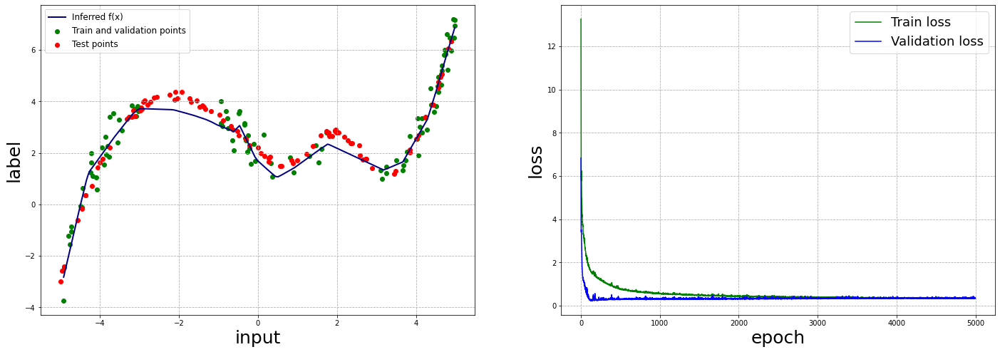

In [ ]:
# Network final output
x_vec = torch.linspace(np.min(train_df.input),np.max(train_df.input),2000)
x_vec = x_vec.to(device)
x_vec = x_vec.unsqueeze(-1)

net.eval()
with torch.no_grad(): 
    y_vec = net(x_vec)
x_vec = x_vec.squeeze().cpu().numpy()
y_vec = y_vec.squeeze().cpu().numpy()


# Plot losses
fig, (ax, bx) = plt.subplots(1,2,figsize=(24,8))

ax.scatter(train_df.input, train_df.label, color='green', label='Train and validation points')
ax.scatter(test_df.input, test_df.label, color='red', label='Test points')
ax.plot(x_vec, y_vec, color='navy', label='Inferred f(x)', linewidth=2)
ax.set_xlabel('input', fontsize=25)
ax.set_ylabel('label', fontsize=25)
ax.grid(linestyle='--')
ax.legend(fontsize=12)

bx.plot(train_loss_log, label='Train loss', color='green')
bx.plot(val_loss_log, label='Validation loss', color='blue')
bx.set_xlabel('epoch', fontsize=25)
bx.set_ylabel('loss', fontsize=25)
bx.grid(linestyle='--')
bx.legend(fontsize=18);

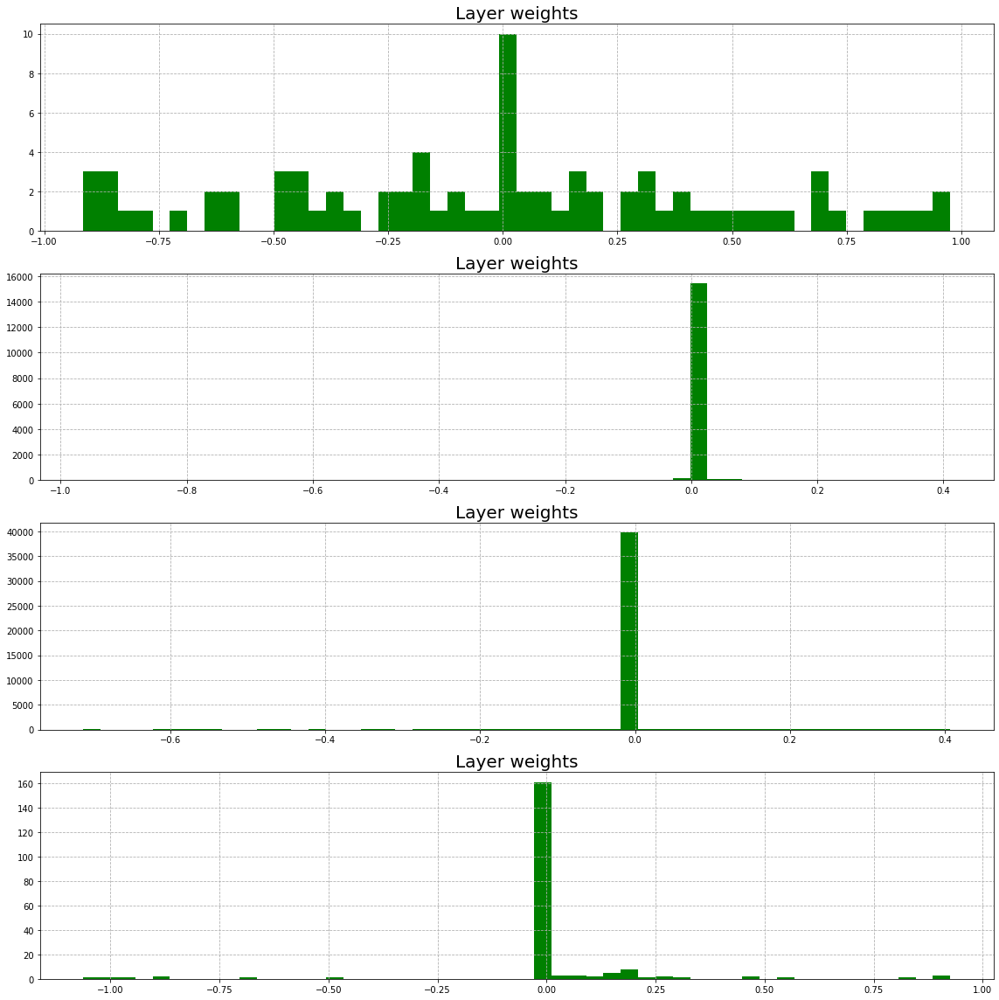

In [ ]:
weights_histogram(net, [net.fc1, net.fc2, net.fc3, net.out])

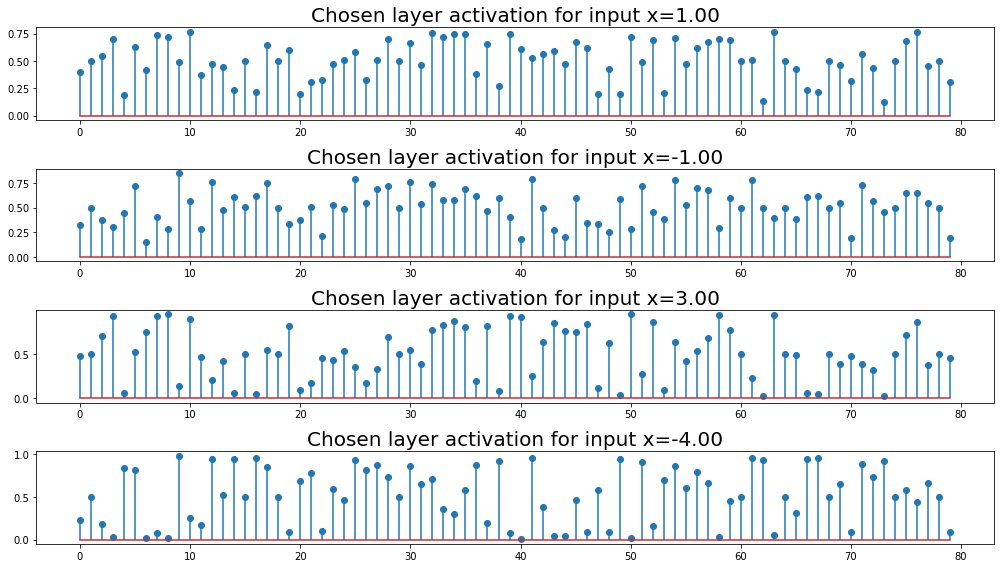

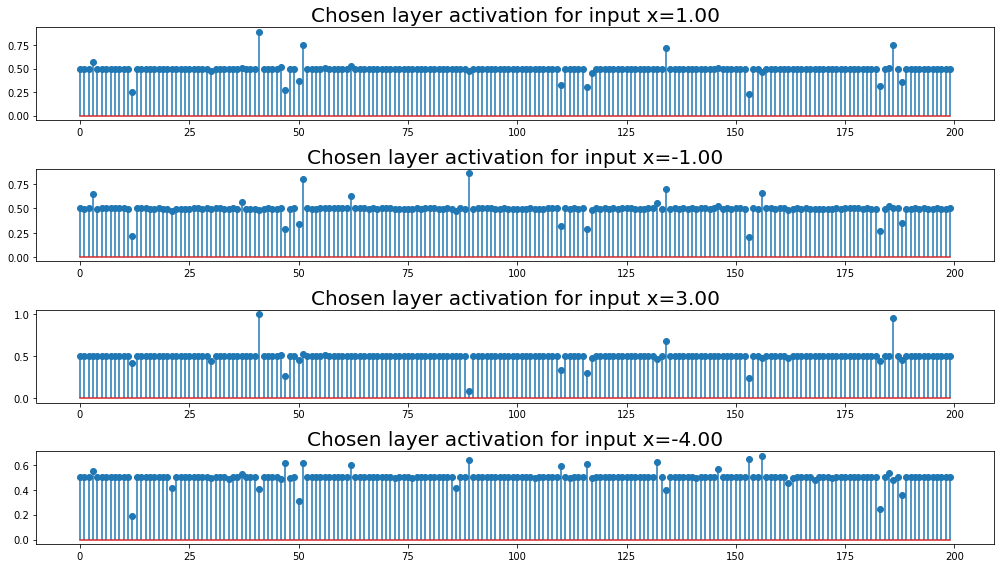

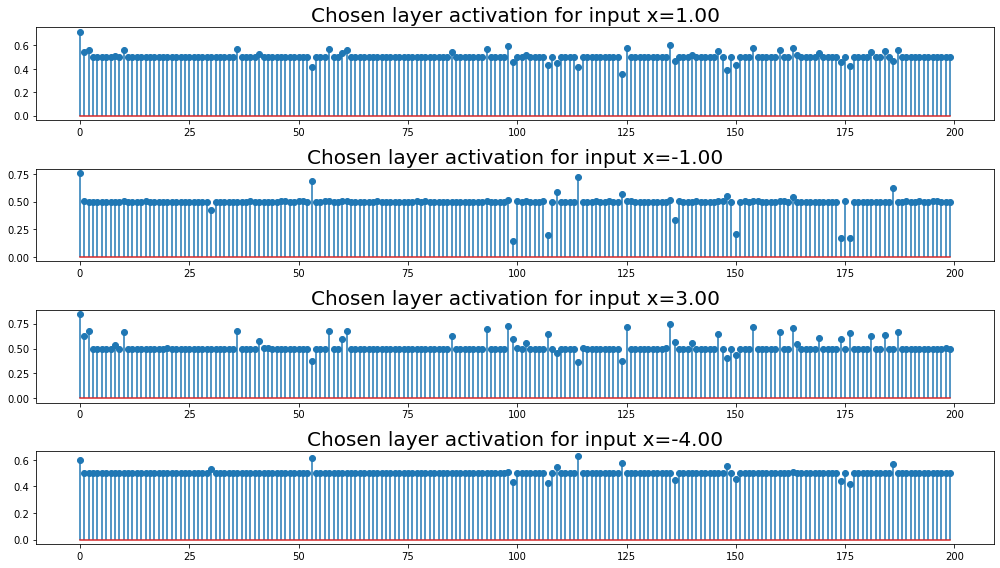

In [ ]:
data = [1, -1, 3, -4]
analyse_activation(net, net.fc1, data)
analyse_activation(net, net.fc2, data)
analyse_activation(net, net.fc3, data)

## Free up space

In [ ]:
import gc
import os
gc.collect()

725

In [ ]:
del train_dataset
del test_dataset
del net
gc.collect()

44

In [ ]:
for file in os.listdir('./'):
    if file.endswith('.png'): os.remove(file) 

# **** Classification task ****

## Guidelines

* The goal is to train a neural network that maps an input image (from fashionMNIST) to one of ten classes (multi-class classification problem with mutually exclusive classes).
* Define a proper loss (e.g. [torch.nn.CrossEntropyLoss](https://pytorch.org/docs/stable/generated/torch.nn.CrossEntropyLoss.html#torch.nn.CrossEntropyLoss))
* Also here, consider to create a validation set from you training data, or use a k-fold cross-validation strategy.
* Pay attention to the shape, data type and output values range. If needed, modify them accordingly to your implementation (read carefully the documentation of the layers that you use, e.g. [torch.nn.Conv2d](https://pytorch.org/docs/stable/generated/torch.nn.Conv2d.html)).
* Explore different optimizers, acivation functions, network architectures. Analyze the effect of different regularization methods, such as dropout layers, random transformations (image rotation, scaling, add noise...) or L2 regularization (weight decay).

## Dataset

In [2]:
# Definition of the transformation to apply to the data during loading
torch.manual_seed(seed)

aug_transform = transforms.Compose([ 
    transforms.RandomRotation(degrees=np.random.randint(0,360)),
    transforms.RandomVerticalFlip(p=0.5),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.ToTensor(), 
    transforms.Normalize((0.5,), (0.5,)),
])

train_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

test_transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

#### Download the dataset:

The output of the dataset is a PIL Image, a python object specifically developed to manage and process images. PyTorch supports this format, and there are useful transforms available natively in the framework: https://pytorch.org/docs/stable/torchvision/transforms.html

In [3]:
### Download the data and create dataset
data_dir = 'dataset'
torch.manual_seed(seed)

train_small_dataset = torchvision.datasets.FashionMNIST(data_dir, train=True, download=True, transform=train_transform)
train_augmented_dataset = torchvision.datasets.FashionMNIST(data_dir, train=True, download=True, transform=aug_transform)
test_dataset  = torchvision.datasets.FashionMNIST(data_dir, train=False, download=True, transform=test_transform)

### concatenate the two train dataset to from a unique augmented dataset
train_dataset = torch.utils.data.ConcatDataset([train_small_dataset, train_augmented_dataset])

  0%|          | 0/26421880 [00:00<?, ?it/s]

Extracting dataset/FashionMNIST/raw/train-images-idx3-ubyte.gz to dataset/FashionMNIST/raw



  0%|          | 0/29515 [00:00<?, ?it/s]

Extracting dataset/FashionMNIST/raw/train-labels-idx1-ubyte.gz to dataset/FashionMNIST/raw



  0%|          | 0/4422102 [00:00<?, ?it/s]

Extracting dataset/FashionMNIST/raw/t10k-images-idx3-ubyte.gz to dataset/FashionMNIST/raw



  0%|          | 0/5148 [00:00<?, ?it/s]

Extracting dataset/FashionMNIST/raw/t10k-labels-idx1-ubyte.gz to dataset/FashionMNIST/raw



### Pre processing

How to get an image and the corresponding label:

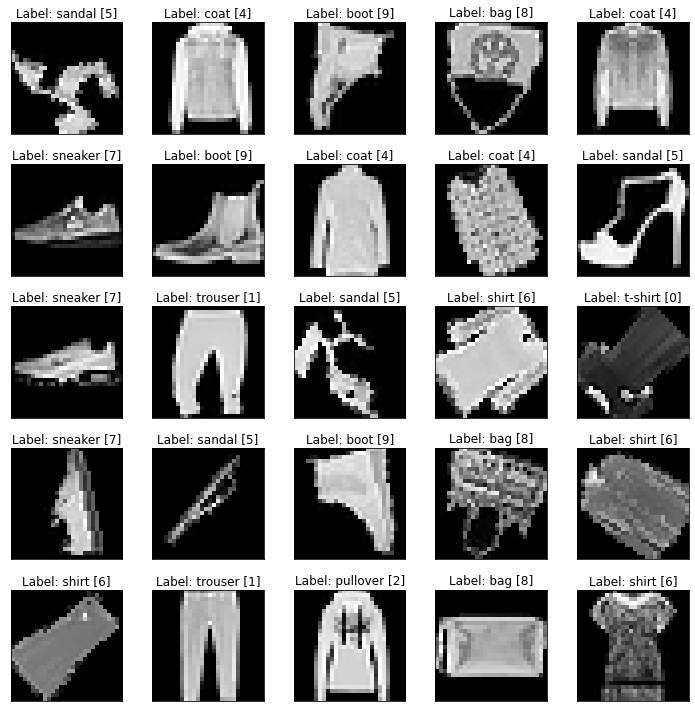

In [16]:
### Plot some sample
label_names=['t-shirt','trouser','pullover','dress','coat','sandal','shirt',
             'sneaker','bag','boot']

fig, axs = plt.subplots(5, 5, figsize=(10,10))
for ax in axs.flatten():
    img, label = random.choice(train_dataset)
    ax.imshow(np.array(img).squeeze(), cmap='gist_gray')
    ax.set_title(f'Label: {label_names[label]} [{label}]')
    ax.set_xticks([])
    ax.set_yticks([])
plt.tight_layout()

In [4]:

N = len(train_dataset)
N_train = int(0.8*len(train_dataset))
N_val = N - N_train
print('Number of samples in training set:', N_train)
print('Number of samples in validation set:', N_val)
print('Number of samples in test set:', len(test_dataset))

# split the training set in train and validation
train, val = sklearn.model_selection.train_test_split(train_dataset, test_size=N_val, train_size=N_train, 
                                             random_state=seed, shuffle=True, stratify=None)

# Define the dataloaders
batch_size = 256
num_workers = 2

train_dataloader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers)
val_dataloader  = DataLoader(val, batch_size=batch_size, shuffle=False, num_workers=num_workers)
test_dataloader = DataLoader(test_dataset, batch_size=len(test_dataset), shuffle=False, num_workers=num_workers)


batch_data, batch_labels = next(iter(train_dataloader))
print(f"TRAIN BATCH SHAPE")
print(f"\t Data: {batch_data.shape}")
print(f"\t Labels: {batch_labels.shape}")

batch_data, batch_labels = next(iter(val_dataloader))
print(f"VAL BATCH SHAPE")
print(f"\t Data: {batch_data.shape}")
print(f"\t Labels: {batch_labels.shape}")

batch_data, batch_labels = next(iter(test_dataloader))
print(f"TEST BATCH SHAPE")
print(f"\t Data: {batch_data.shape}")
print(f"\t Labels: {batch_labels.shape}")

Number of samples in training set: 96000
Number of samples in validation set: 24000
Number of samples in test set: 10000
TRAIN BATCH SHAPE
	 Data: torch.Size([256, 1, 28, 28])
	 Labels: torch.Size([256])
VAL BATCH SHAPE
	 Data: torch.Size([256, 1, 28, 28])
	 Labels: torch.Size([256])
TEST BATCH SHAPE
	 Data: torch.Size([10000, 1, 28, 28])
	 Labels: torch.Size([10000])


## Definition of the model

In [5]:
class CNNnet(nn.Module):
    
    def __init__(self, filters1=32, filters2=64, linear1=600, linear2=120, p=0.25):
        super().__init__()
        
        ### Convolutional section
        self.cnn = nn.Sequential(
            # first conv block
            nn.Conv2d(in_channels=1, out_channels=filters1, kernel_size=(3,3), padding=1),
            nn.BatchNorm2d(num_features=filters1),
            nn.ReLU(),
            nn.MaxPool2d((2,2), stride=2),
            # second conv block
            nn.Conv2d(in_channels=filters1, out_channels=filters2, kernel_size=(3,3)),
            nn.BatchNorm2d(num_features=filters2),
            nn.ReLU(),
            nn.MaxPool2d((2,2))
        )
        
        ### Flatten layer
        self.flatten = nn.Flatten(start_dim=1)

        ### Linear section
        self.lin = nn.Sequential(
            nn.Linear(in_features=filters2*6*6, out_features=linear1), # filters2*7*7 = 784
            nn.Dropout2d(p),
            nn.Linear(in_features=linear1, out_features=linear2),
            nn.Linear(in_features=linear2, out_features=10)
        )
        
    def forward(self, x):
        # Apply convolutions
        x = self.cnn(x)
        # Flatten
        x = self.flatten(x)
        # # Apply linear layers
        x = self.lin(x)
        return x

In [6]:
# define the sparse loss function
def sparse_loss(model):
    l1_parameters = []
    for parameter in model.parameters():
      l1_parameters.append(parameter.view(-1))
    loss = torch.abs(torch.cat(l1_parameters)).sum()
    return loss

In [7]:
torch.manual_seed(seed)

### Training function
def train_epoch(model, device, dataloader, loss_fn, optimizer, sparsity=False, reg_param=0.001, verbose=0):
    # Set train mode 
    model.train()
    
    for image_batch, label_batch in tqdm(dataloader): 
        # Move tensor to the proper device
        image_batch = image_batch.to(device)
        label_batch = label_batch.to(device)
        # Encode data
        out = model(image_batch)

        # Evaluate loss
        loss = loss_fn(out, label_batch)

        if sparsity:
          l1_loss = sparse_loss(model)
          # add the sparsity penalty
          loss = loss + reg_param*l1_loss

        # Backward pass
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        # Print batch loss
        if verbose:
          print('\t partial train loss (single batch): %f' % (loss.data))

    return loss.data

### Testing function
def test_epoch(model, device, dataloader, loss_fn):
    # Set evaluation mode 
    model.eval()

    with torch.no_grad(): # No need to track the gradients
        # Define the lists to store the outputs for each batch
        conc_out = []
        conc_label = []
        for image_batch, label_batch in tqdm(dataloader):
            # Move tensor to the proper device
            image_batch = image_batch.to(device)

            # Encode data
            out = model(image_batch)

            # Append the network output and the original image to the lists
            conc_out.append(out.cpu())
            conc_label.append(label_batch)

        # Create a single tensor with all the values in the lists
        conc_out = torch.cat(conc_out)
        conc_label = torch.cat(conc_label)

        # Evaluate global loss
        val_loss = loss_fn(conc_out, conc_label)

    return conc_out, conc_label, val_loss.data

In [8]:
# to set the inizialization of the weights
def initialize_weights(m):
    if isinstance(m, nn.Conv2d):
      nn.init.xavier_uniform_(m.weight.data)
    elif isinstance(m, nn.BatchNorm2d):
      nn.init.constant_(m.weight.data, 1)
    elif isinstance(m, nn.Linear):
      nn.init.kaiming_uniform_(m.weight.data)

In [9]:
# Defining the function for plotting the confusion matrix
def show_cm(valid, predict):
    matrix = confusion_matrix(valid, predict, normalize='true')
    plt.figure(figsize = (12,8))
    seaborn.heatmap(matrix,
                   xticklabels = label_names,
                   yticklabels = label_names,
                   annot = True,
                   #fmt = 'd',
                   linecolor = 'white',
                   linewidths = 1,
                   cmap='Blues')
    plt.title('Confusion Matrix', fontsize=20)
    plt.ylabel('True label', fontsize=15)
    plt.xlabel('Predicted label', fontsize=15)
    plt.show()

    return matrix

## Training

In [10]:
torch.manual_seed(seed)

model = CNNnet(filters1=32, filters2=64, linear1=600, linear2=120)
model.apply(initialize_weights) # weights inizialization

### Define the loss function
loss_fn = nn.CrossEntropyLoss()

### Define an optimizer
lr = 5e-3 # Learning rate
weight_decay = 5e-4 # l2 regularizer
opt = torch.optim.Adam(model.parameters(), lr=lr, weight_decay=weight_decay)

# Check if the GPU is available
device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
print(f'Selected device: {device}')

# Move both the encoder and the decoder to the selected device
model.to(device)

summary(model, (1,28,28))

Selected device: cpu
----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1           [-1, 32, 28, 28]             320
       BatchNorm2d-2           [-1, 32, 28, 28]              64
              ReLU-3           [-1, 32, 28, 28]               0
         MaxPool2d-4           [-1, 32, 14, 14]               0
            Conv2d-5           [-1, 64, 12, 12]          18,496
       BatchNorm2d-6           [-1, 64, 12, 12]             128
              ReLU-7           [-1, 64, 12, 12]               0
         MaxPool2d-8             [-1, 64, 6, 6]               0
           Flatten-9                 [-1, 2304]               0
           Linear-10                  [-1, 600]       1,383,000
        Dropout2d-11                  [-1, 600]               0
           Linear-12                  [-1, 120]          72,120
           Linear-13                   [-1, 10]           1,210
Total params: 1,47

In [21]:
torch.manual_seed(seed)

### Training loop
num_epochs = 15

history = {'train_accuracy': [],
           'train_loss' : [],
           'val_accuracy': [],
           'val_loss' : []}

for epoch in range(num_epochs):
    print('EPOCH %d/%d' % (epoch + 1, num_epochs))
    ### Training
    train_loss = train_epoch(
        model=model,
        device=device, 
        dataloader=train_dataloader, 
        loss_fn=loss_fn, 
        optimizer=opt, sparsity=False, reg_param=0.001)
    
    x_test, y_test = next(iter(train_dataloader))
    y_pred = (model(x_test.to(device)).argmax(dim=1))
    y_pred = y_pred.cpu()
    train_acc = 0
    for i in range(len(y_test)):
      if y_test[i] == y_pred[i]: train_acc+=1
    train_acc = train_acc/len(y_test)*100
    
    ### Validation
    _, _, val_loss = test_epoch(
        model=model,
        device=device, 
        dataloader=val_dataloader, 
        loss_fn=loss_fn)
    
    x_test, y_test = next(iter(val_dataloader))
    y_pred = (model(x_test.to(device)).argmax(dim=1))
    y_pred = y_pred.cpu()
    val_acc = 0
    for i in range(len(y_test)):
      if y_test[i] == y_pred[i]: val_acc+=1
    val_acc = val_acc/len(y_test)*100

    # Print loss and accuracy
    print('\n\n\t TRAINING   - EPOCH %d/%d - loss: %0.3f - acc: %0.1f %%' % (epoch + 1, num_epochs, train_loss, train_acc))
    print('\t VALIDATION - EPOCH %d/%d - loss: %0.3f - acc: %0.1f %%\n\n' % (epoch + 1, num_epochs, val_loss, val_acc))

    # save accuracy and loss for train and validation
    history['train_accuracy'].append(train_acc)
    history['train_loss'].append(train_loss)
    history['val_accuracy'].append(val_acc)
    history['val_loss'].append(val_loss)

    # Save network parameters
    torch.save(model.state_dict(), 'model_params.pth')

EPOCH 1/15


  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 1/15 - loss: 0.822 - acc: 69.1 %
	 VALIDATION - EPOCH 1/15 - loss: 0.886 - acc: 63.7 %


EPOCH 2/15


  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 2/15 - loss: 0.835 - acc: 80.5 %
	 VALIDATION - EPOCH 2/15 - loss: 0.745 - acc: 67.2 %


EPOCH 3/15


  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 3/15 - loss: 0.563 - acc: 73.4 %
	 VALIDATION - EPOCH 3/15 - loss: 0.739 - acc: 67.6 %


EPOCH 4/15


  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 4/15 - loss: 0.585 - acc: 82.0 %
	 VALIDATION - EPOCH 4/15 - loss: 0.675 - acc: 71.9 %


EPOCH 5/15


  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 5/15 - loss: 0.510 - acc: 81.2 %
	 VALIDATION - EPOCH 5/15 - loss: 0.588 - acc: 75.8 %


EPOCH 6/15


  0%|          | 0/375 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 6/15 - loss: 0.645 - acc: 75.8 %
	 VALIDATION - EPOCH 6/15 - loss: 0.621 - acc: 74.6 %


EPOCH 7/15


  0%|          | 0/375 [00:00<?, ?it/s]

KeyboardInterrupt: 

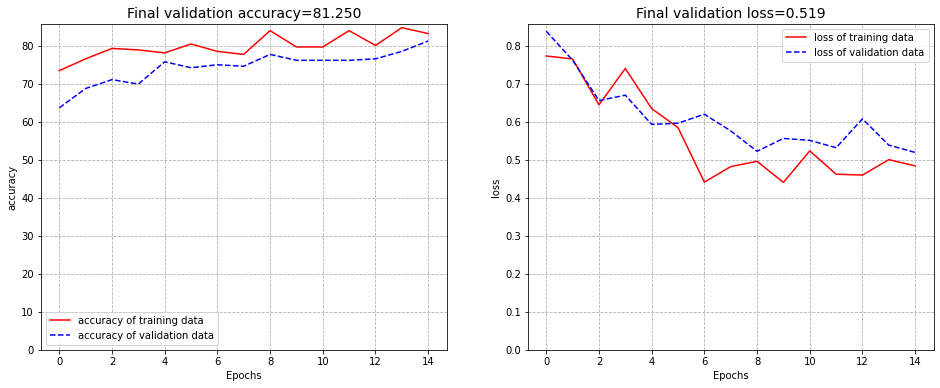

In [ ]:
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(16,6))
count=0
for obs in ('accuracy','loss'):
    ax[count].plot(history['train_' + obs], 'r', label = obs + ' of training data')
    ax[count].plot(history['val_' + obs], 'b--', label = obs + ' of validation data')
    ax[count].set_ylabel(obs)
    ax[count].set_xlabel('Epochs')
    ax[count].legend()
    ax[count].set_ylim(0)
    ax[count].grid(linestyle='--')
    ax[count].set_title('Final validation {}={:.3f}' .format(obs,history['val_'+obs][-1]),
                        fontsize=14)
    count+=1
plt.show()

#### Test set

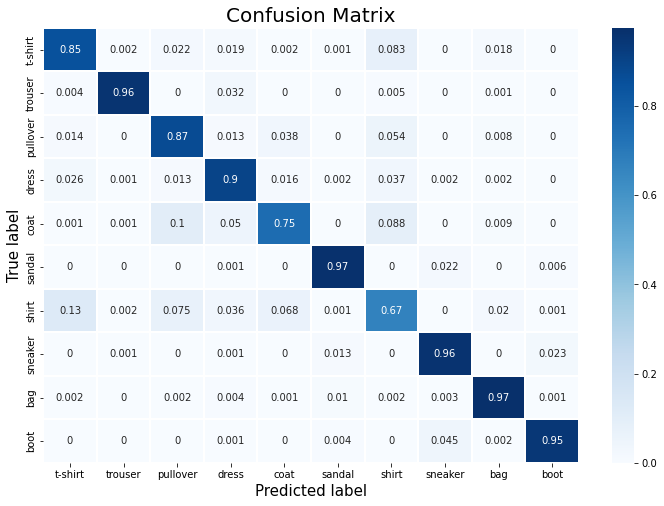

In [ ]:
#label_names = np.arange(0,10,1)

# Initialize the prediction and label lists(tensors)
pred_list = torch.zeros(0,dtype=torch.long, device='cpu')
lbl_list = torch.zeros(0,dtype=torch.long, device='cpu')

with torch.no_grad():
    for i, (inputs, classes) in enumerate(test_dataloader):
        inputs = inputs.to(device)
        classes = classes.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)

        # Append batch prediction results
        pred_list = torch.cat([pred_list,preds.view(-1).cpu()])
        lbl_list = torch.cat([lbl_list,classes.view(-1).cpu()])

# Confusion matrix
conf_mat = show_cm(lbl_list.numpy(), pred_list.numpy())

In [ ]:
# Per-class accuracy
class_accuracy = 100*conf_mat.diagonal()/conf_mat.sum(1)

pc = pd.DataFrame(class_accuracy, index=label_names, columns=['Accuracy per class(%)'])
pc

,Accuracy per class(%)
t-shirt,85.3
trouser,95.8
pullover,87.3
dress,90.1
coat,74.8
sandal,97.1
shirt,66.9
sneaker,96.2
bag,97.5
boot,94.8


In [ ]:
_, _, test_loss = test_epoch(
        model=model,
        device=device, 
        dataloader=test_dataloader, 
        loss_fn=loss_fn)

print('\n-----FINAL RESULTS-----')
print(f'TEST LOSS: %0.3f' % test_loss)
print(f'TEST ACCURACY: %0.1f %%' % np.mean(class_accuracy))

  0%|          | 0/1 [00:00<?, ?it/s]


-----FINAL RESULTS-----
TEST LOSS: 0.327
TEST ACCURACY: 88.6 %


### Hyper-parameters optimization

In [ ]:
def objective(trial):

    # hyperparameters to optimize
    hyper_parameters=[
        trial.suggest_int('number_of_epochs', 10, 10, 2),
        trial.suggest_int('batch_size', 50, 300, 10),
        trial.suggest_discrete_uniform("p", 0.0, 0.4, 0.05),
        trial.suggest_discrete_uniform("lr", 0.0005, 0.01, 0.0005),
        trial.suggest_categorical("optimizer", ["Adam", "RMSprop"]), # SGD
        trial.suggest_categorical("weight_decay", [5e-5, 1e-4, 5e-4, 1e-3]),
        trial.suggest_int('filters1', 10, 70, 5),
        trial.suggest_int('filters2', 30, 100, 5),
        trial.suggest_int('linear1', 300, 800, 5),
        trial.suggest_int('linear2', 60, 200, 5),
    ]

    ###########################################################################################################

    # Define the dataloaders
    batch_size = hyper_parameters[1]

    train_dataloader = DataLoader(train, batch_size=batch_size, shuffle=True, num_workers=num_workers)

    torch.manual_seed(seed)

    model = CNNnet(filters1=hyper_parameters[6], filters2=hyper_parameters[7], linear1=hyper_parameters[8], linear2=hyper_parameters[9], p=hyper_parameters[2])
    model.apply(initialize_weights) # weights inizialization

    ### Define the loss function
    loss_fn = nn.CrossEntropyLoss()

    ### Define an optimizer
    lr = hyper_parameters[3] # Learning rate
    weight_decay = hyper_parameters[5] # l2 regularizer
    opt = getattr(optim, hyper_parameters[4])(model.parameters(), lr=lr, weight_decay=weight_decay)

    # Check if the GPU is available
    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    print(f'Selected device: {device}')

    # Move both the encoder and the decoder to the selected device
    model.to(device)

    ###########################################################################################################

    ### Training loop
    num_epochs = hyper_parameters[0]

    history = {'train_accuracy': [],
              'train_loss' : [],
              'val_accuracy': [],
              'val_loss' : []}

    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_loss = train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=opt)
        
        x_test, y_test = next(iter(train_dataloader))
        y_pred = (model(x_test.to(device)).argmax(dim=1))
        y_pred = y_pred.cpu()
        train_acc = 0
        for i in range(len(y_test)):
          if y_test[i] == y_pred[i]: train_acc+=1
        train_acc = train_acc/len(y_test)*100
        
        ### Validation
        _, _, val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=val_dataloader, 
            loss_fn=loss_fn)
        
        x_test, y_test = next(iter(val_dataloader))
        y_pred = (model(x_test.to(device)).argmax(dim=1))
        y_pred = y_pred.cpu()
        val_acc = 0
        for i in range(len(y_test)):
          if y_test[i] == y_pred[i]: val_acc+=1
        val_acc = val_acc/len(y_test)*100

        # Print loss and accuracy
        print('\n\n\t TRAINING   - EPOCH %d/%d - loss: %0.3f - acc: %0.1f %%' % (epoch + 1, num_epochs, train_loss, train_acc))
        print('\t VALIDATION - EPOCH %d/%d - loss: %0.3f - acc: %0.1f %%\n\n' % (epoch + 1, num_epochs, val_loss, val_acc))

        # save accuracy and loss for train and validation
        history['train_accuracy'].append(train_acc)
        history['train_loss'].append(train_loss)
        history['val_accuracy'].append(val_acc)
        history['val_loss'].append(val_loss)

        # Save network parameters
        #torch.save(model.state_dict(), 'model_params.pth')


    return history['val_loss'][-1]

study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=20) # n_jobs=2, # 20 trials

pruned_trials = [t for t in study.trials if t.state == optuna.structs.TrialState.PRUNED]
complete_trials = [t for t in study.trials if t.state == optuna.structs.TrialState.COMPLETE]

[I 2021-12-27 15:10:07,524] A new study created in memory with name: no-name-05e22e93-d875-417a-8d7a-49e2f4550bda


Selected device: cuda
EPOCH 1/5


  0%|          | 0/370 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 1/5 - loss: 0.980 - acc: 71.2 %
	 VALIDATION - EPOCH 1/5 - loss: 1.099 - acc: 59.0 %


EPOCH 2/5


  0%|          | 0/370 [00:00<?, ?it/s]

  0%|          | 0/94 [00:00<?, ?it/s]



	 TRAINING   - EPOCH 2/5 - loss: 0.594 - acc: 69.6 %
	 VALIDATION - EPOCH 2/5 - loss: 0.999 - acc: 57.8 %


EPOCH 3/5


  0%|          | 0/370 [00:00<?, ?it/s]

KeyboardInterrupt: ignored

In [ ]:
print("Study statistics: ")
print("  Number of finished trials: ", len(study.trials))
print("  Number of pruned trials: ", len(pruned_trials))
print("  Number of complete trials: ", len(complete_trials))

print("Best trial:")
trial = study.best_trial

print("  Value: ", trial.value)

print("  Params: ")
for key, value in trial.params.items():
  print("    {}: {}".format(key, value))

### K-fold cross validation

Due to some technical problems with Google Cloud, the parameters of each fold are saved in a folder in the same directory of the notebook and the best parameters are reported in the following cell.

In [11]:
params = trial.params
#params = {'batch_size': 300, 'p': 0.40, 'lr': 0.0085, 'optimizer': 'Adam', 'weight_decay': 0.00005, 'filters1': 35, 'filters2': 35, 'linear1': 375, 'linear2': 105}

In [12]:
k_folds = 5
n_best = 0
best_loss = 100
val_results = {}
kfold = KFold(n_splits=k_folds, shuffle=True)
    
# Start print
print('--------------------------------')

# K-fold Cross Validation model evaluation
for fold, (train_ids, test_ids) in enumerate(kfold.split(train_dataset)):
    
    # Print
    print(f'FOLD {fold+1}')
    print('--------------------------------')
    
    # Sample elements randomly from a given list of ids, no replacement.
    train_subsampler = torch.utils.data.SubsetRandomSampler(train_ids)
    test_subsampler = torch.utils.data.SubsetRandomSampler(test_ids)
    
    # Define the dataloaders
    num_workers = 2
    batch_size = params['batch_size']

    train_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, sampler=test_subsampler)
    test_dataloader = torch.utils.data.DataLoader(train_dataset, batch_size=batch_size, sampler=test_subsampler)

    ###########################################################################################################

    torch.manual_seed(seed)

    model = CNNnet(filters1=params['filters1'], filters2=params['filters2'], 
                   linear1=params['linear1'], linear2=params['linear2'], p=params['p'])
    model.apply(initialize_weights) # weights inizialization

    ### Define the loss function
    loss_fn = nn.CrossEntropyLoss()

    ### Define an optimizer
    lr = params['lr'] # Learning rate
    weight_decay = params['weight_decay'] # l2 regularizer
    opt = getattr(torch.optim, params['optimizer'])(model.parameters(), lr=lr, weight_decay=weight_decay)

    # Check if the GPU is available
    device = torch.device("cuda") if torch.cuda.is_available() else torch.device("cpu")
    print(f'Selected device: {device}')

    # Move both the encoder and the decoder to the selected device
    model.to(device)

    ###########################################################################################################

    ### Training loop
    num_epochs = 20 #params['number_of_epochs']

    history = {'train_accuracy': [],
              'train_loss' : [],
              'val_accuracy': [],
              'val_loss' : []}

    for epoch in range(num_epochs):
        print('EPOCH %d/%d' % (epoch + 1, num_epochs))
        ### Training
        train_loss = train_epoch(
            model=model,
            device=device, 
            dataloader=train_dataloader, 
            loss_fn=loss_fn, 
            optimizer=opt)
        
        x_test, y_test = next(iter(train_dataloader))
        y_pred = (model(x_test.to(device)).argmax(dim=1))
        y_pred = y_pred.cpu()
        train_acc = 0
        for i in range(len(y_test)):
          if y_test[i] == y_pred[i]: train_acc+=1
        train_acc = train_acc/len(y_test)*100
        
        ### Validation
        _, _, val_loss = test_epoch(
            model=model,
            device=device, 
            dataloader=test_dataloader, 
            loss_fn=loss_fn)
        
        x_test, y_test = next(iter(val_dataloader))
        y_pred = (model(x_test.to(device)).argmax(dim=1))
        y_pred = y_pred.cpu()
        val_acc = 0
        for i in range(len(y_test)):
          if y_test[i] == y_pred[i]: val_acc+=1
        val_acc = val_acc/len(y_test)*100

        # save accuracy and loss for train and validation
        history['train_accuracy'].append(train_acc)
        history['train_loss'].append(train_loss)
        history['val_accuracy'].append(val_acc)
        history['val_loss'].append(val_loss)


    # Saving the model
    save_path = f'./model-fold-{fold}.pth'
    torch.save(model.state_dict(), save_path)

    # Print loss
    print('\n\n\t TRAINING - FOLD %d/%d - loss: %0.3f - acc: %0.1f %%' % (fold+1, k_folds, history['train_loss'][-1], history['train_accuracy'][-1]))
    print('\t VALIDATION   - FOLD %d/%d - loss: %0.3f - acc: %0.1f %%\n\n' % (fold+1, k_folds, history['val_loss'][-1], history['val_accuracy'][-1]))
    print('--------------------------------')
    val_results[fold] = [history['val_loss'][-1], history['val_accuracy'][-1]]
    
    if history['val_loss'][-1] < best_loss: n_best = fold
    
# Print fold results
print(f'K-FOLD CROSS VALIDATION RESULTS FOR {k_folds} FOLDS')
print('--------------------------------')
sum_loss = 0.0
sum_acc = 0.0
for key, value in val_results.items():
  print(f'Fold {key}: loss={value[0]} acc={value[1]}')
  sum_loss += value[0]
  sum_acc += value[1]
print(f'Average Validation Loss: {sum_loss/len(val_results.items())}')
print(f'Average Validations Accuracy: {sum_acc/len(val_results.items())}')

--------------------------------
FOLD 1
--------------------------------
Selected device: cpu
EPOCH 1/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 2/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 3/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 4/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 5/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 6/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 7/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 8/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 9/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 10/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 11/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 12/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 13/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 14/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 15/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 16/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 17/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 18/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 19/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 20/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]



	 TRAINING - FOLD 1/5 - loss: 0.566 - acc: 76.3 %
	 VALIDATION   - FOLD 1/5 - loss: 0.567 - acc: 76.2 %


--------------------------------
FOLD 2
--------------------------------
Selected device: cpu
EPOCH 1/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 2/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 3/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 4/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 5/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 6/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 7/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 8/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 9/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 10/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 11/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 12/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 13/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 14/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 15/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 16/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 17/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 18/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 19/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 20/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]



	 TRAINING - FOLD 2/5 - loss: 0.633 - acc: 80.7 %
	 VALIDATION   - FOLD 2/5 - loss: 0.566 - acc: 75.8 %


--------------------------------
FOLD 3
--------------------------------
Selected device: cpu
EPOCH 1/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 2/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 3/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 4/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 5/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 6/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 7/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 8/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 9/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 10/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 11/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 12/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 13/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 14/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 15/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 16/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 17/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 18/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 19/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 20/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]



	 TRAINING - FOLD 3/5 - loss: 0.555 - acc: 80.7 %
	 VALIDATION   - FOLD 3/5 - loss: 0.549 - acc: 78.1 %


--------------------------------
FOLD 4
--------------------------------
Selected device: cpu
EPOCH 1/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 2/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 3/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 4/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 5/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 6/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 7/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 8/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 9/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 10/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 11/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 12/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 13/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 14/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 15/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 16/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 17/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 18/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 19/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 20/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]



	 TRAINING - FOLD 4/5 - loss: 0.575 - acc: 80.3 %
	 VALIDATION   - FOLD 4/5 - loss: 0.569 - acc: 76.6 %


--------------------------------
FOLD 5
--------------------------------
Selected device: cpu
EPOCH 1/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 2/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 3/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 4/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 5/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 6/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 7/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 8/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 9/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 10/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 11/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 12/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 13/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 14/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 15/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 16/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 17/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 18/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 19/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]

EPOCH 20/20


  0%|          | 0/80 [00:00<?, ?it/s]

  0%|          | 0/80 [00:00<?, ?it/s]



	 TRAINING - FOLD 5/5 - loss: 0.612 - acc: 79.0 %
	 VALIDATION   - FOLD 5/5 - loss: 0.558 - acc: 75.8 %


--------------------------------
K-FOLD CROSS VALIDATION RESULTS FOR 5 FOLDS
--------------------------------
Fold 0: loss=0.5672573447227478 acc=76.171875
Fold 1: loss=0.5655174851417542 acc=75.78125
Fold 2: loss=0.5493102073669434 acc=78.125
Fold 3: loss=0.5686030983924866 acc=76.5625
Fold 4: loss=0.5581582188606262 acc=75.78125
Average Validation Loss: 0.5617692470550537
Average Validations Accuracy: 76.484375


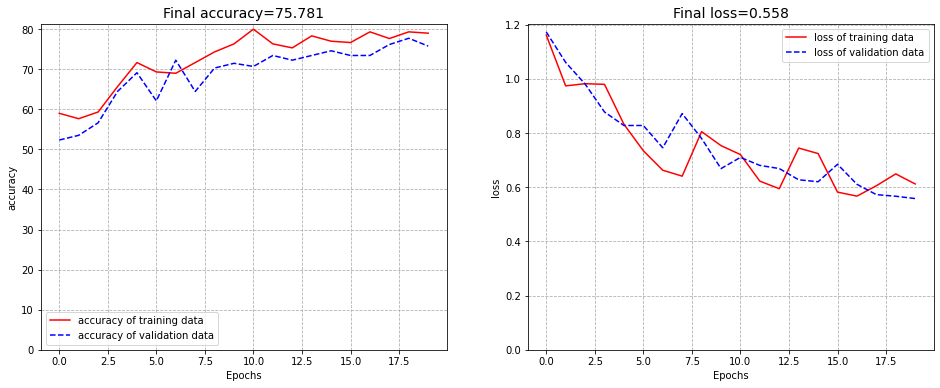

In [13]:
fig,ax=plt.subplots(nrows=1,ncols=2,figsize=(16,6))
count=0
for obs in ('accuracy','loss'):
    ax[count].plot(history['train_' + obs], 'r', label = obs + ' of training data')
    ax[count].plot(history['val_' + obs], 'b--', label = obs + ' of validation data')
    ax[count].set_ylabel(obs)
    ax[count].set_xlabel('Epochs')
    ax[count].legend()
    ax[count].set_ylim(0)
    ax[count].grid(linestyle='--')
    ax[count].set_title('Final {}={:.3f}' .format(obs,history['val_'+obs][-1]),
                        fontsize=14)
    count+=1
plt.show()

## Interpretability

In [15]:
# Load saved parameters of one fold
fold_n = n_best
# f'./fold_parameters/model-fold-{fold_n}.pth' to load the trained parameters in google cloud
load_path = f'./model-fold-{fold_n}.pth' 
model.load_state_dict(torch.load(load_path))

<All keys matched successfully>

### Confusion matrix

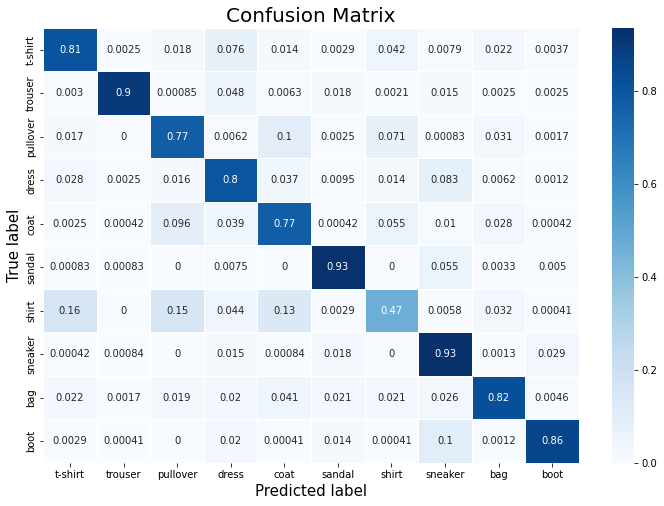

In [17]:
# Initialize the prediction and label lists(tensors)
pred_list = torch.zeros(0,dtype=torch.long, device='cpu')
lbl_list = torch.zeros(0,dtype=torch.long, device='cpu')

with torch.no_grad():
    for i, (inputs, classes) in enumerate(test_dataloader):
        inputs = inputs.to(device)
        classes = classes.to(device)
        outputs = model(inputs)
        _, preds = torch.max(outputs, 1)

        # Append batch prediction results
        pred_list = torch.cat([pred_list,preds.view(-1).cpu()])
        lbl_list = torch.cat([lbl_list,classes.view(-1).cpu()])

# Confusion matrix
conf_mat = show_cm(lbl_list.numpy(), pred_list.numpy())

In [18]:
# Per-class accuracy
class_accuracy = 100*conf_mat.diagonal()/conf_mat.sum(1)

pc = pd.DataFrame(class_accuracy, index=label_names, columns=['Accuracy per class(%)'])
pc

,Accuracy per class(%)
t-shirt,81.049563
trouser,90.186125
pullover,76.935818
dress,80.305533
coat,76.816464
sandal,92.750000
shirt,46.721992
sneaker,93.484657
bag,82.429048
boot,85.731908


In [19]:
_, _, test_loss = test_epoch(
        model=model,
        device=device, 
        dataloader=test_dataloader, 
        loss_fn=loss_fn)

print('\n-----FINAL RESULTS-----')
print(f'TEST LOSS: %0.3f' % test_loss)
print(f'TEST ACCURACY: %0.1f %%' % np.mean(class_accuracy))

  0%|          | 0/80 [00:00<?, ?it/s]


-----FINAL RESULTS-----
TEST LOSS: 0.559
TEST ACCURACY: 80.6 %


### Filters

In [ ]:
### Plot the weights (this is a utility function, no need to analyze this code)
def plot_nchw_data(data, h_num, v_num, title):
    fig, axs = plt.subplots(h_num, v_num, figsize=(6,6))
    shape = data.shape
    data = data.reshape(shape[0]*shape[1], shape[2], shape[3])
    for idx, ax in enumerate(axs.flatten()):
        ax.set_xticks([])
        ax.set_yticks([])
        if idx < len(data):
            ax.imshow(data[idx,:,:], cmap='gray')
    plt.suptitle(title, fontsize=15)
    plt.tight_layout(rect=[0, 0, 1, 0.97], h_pad=0, w_pad=0)
    plt.show()

In [ ]:
print(model)

CNNnet(
  (cnn): Sequential(
    (0): Conv2d(1, 34, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(34, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU()
    (3): MaxPool2d(kernel_size=(2, 2), stride=2, padding=0, dilation=1, ceil_mode=False)
    (4): Conv2d(34, 70, kernel_size=(3, 3), stride=(1, 1))
    (5): BatchNorm2d(70, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU()
    (7): MaxPool2d(kernel_size=(2, 2), stride=(2, 2), padding=0, dilation=1, ceil_mode=False)
  )
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (lin): Sequential(
    (0): Linear(in_features=2520, out_features=400, bias=True)
    (1): Dropout2d(p=0.4, inplace=False)
    (2): Linear(in_features=400, out_features=190, bias=True)
    (3): Linear(in_features=190, out_features=10, bias=True)
  )
)


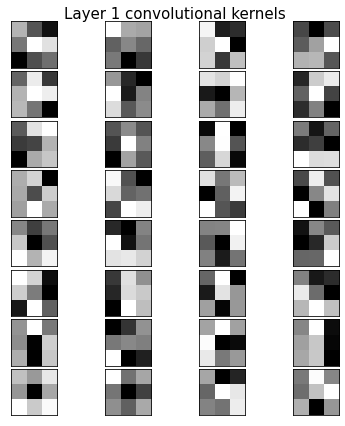

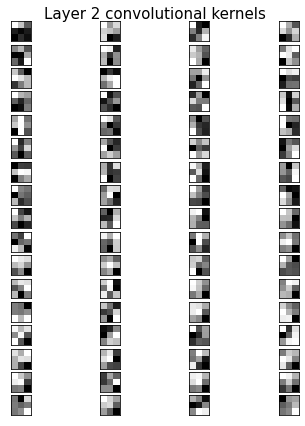

In [ ]:
# access model weights of convolutional layers and plot them

weights_l1 = model.cnn[0].weight.data.cpu().numpy()
plot_nchw_data(weights_l1, int(trial.params['filters1']/4), 4, 'Layer 1 convolutional kernels')

weights_l2 = model.cnn[4].weight.data.cpu().numpy()
plot_nchw_data(weights_l2, int(trial.params['filters2']/4), 4, 'Layer 2 convolutional kernels')

### Intermediate layer outputs

In [ ]:
# Hook function to call during forward pass
def hook_fn(module, input, output):
    intermediate_outputs.append(output)

# Attach hook function to all the convolutional layers
hook_handles = [] # This list will contains all the handles required to remove the hooks later
hook_handles.append(model.cnn[0].register_forward_hook(hook_fn))
hook_handles.append(model.cnn[4].register_forward_hook(hook_fn))

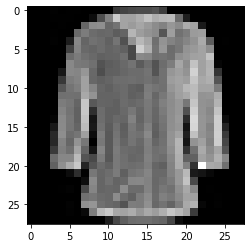

In [ ]:
# Define input: an image of test set (4th)
net_input = test_dataset[4][0].unsqueeze(0)
plt.imshow(net_input.reshape(28,28), cmap='gist_gray')
net_input = net_input.to(device)

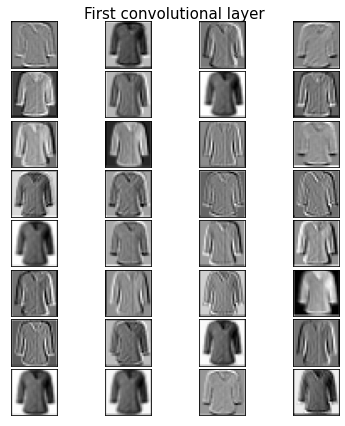

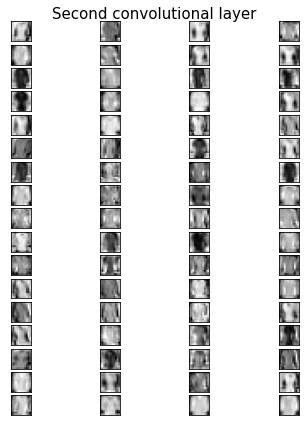

In [ ]:
# Evaluate output
model.eval()
with torch.no_grad():
    intermediate_outputs = []
    out = model(net_input)

# Analyze intermediate outputs
intermediate_output = intermediate_outputs[0].cpu().data.numpy()
plot_nchw_data(intermediate_output, int(trial.params['filters1']/4), 4, 'First convolutional layer')

intermediate_output = intermediate_outputs[1].cpu().data.numpy()
plot_nchw_data(intermediate_output, int(trial.params['filters2']/4), 4, 'Second convolutional layer')

### Space visualization

In [ ]:
# Hook function to call during forward pass 
def hook_feature_space(module, input, output):
    feature_space.append(output) # feature_space must be a list defined before evaluating the network output

# Attach the hook function to the chosen layer 
hook_handle = model.cnn[0].register_forward_hook(hook_feature_space)

In [ ]:
feature_space = [] # This list will be filled by the feature space values

### Analyze all the test samples
test_outputs, test_labels, test_loss = test_epoch(
    model=model,
    device=device, 
    dataloader=test_dataloader, 
    loss_fn=loss_fn)

# Concatenate all the features in a single tensor
feature_space = torch.cat(feature_space)

  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
feature_space = feature_space.cpu()
test_labels   = test_labels.cpu()
test_outputs  = test_outputs.cpu()

In [ ]:
### t-SNE embedding of test_outputs

print("Computing t-SNE embedding")
tsne = TSNE(n_components=2, init='pca', random_state=seed)
feature_space_tsne = tsne.fit_transform(test_outputs)

print(f"FEATURE SPACE SHAPE: {feature_space.shape}")
print(f"FEATURE SPACE SHAPE (TSNE): {feature_space_tsne.shape}")

Computing t-SNE embedding


/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:793: FutureWarning:

The default learning rate in TSNE will change from 200.0 to 'auto' in 1.2.

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_t_sne.py:986: FutureWarning:

The PCA initialization in TSNE will change to have the standard deviation of PC1 equal to 1e-4 in 1.2. This will ensure better convergence.



FEATURE SPACE SHAPE: torch.Size([24000, 34, 28, 28])
FEATURE SPACE SHAPE (TSNE): (24000, 2)


In [ ]:
# Prepare dataframe for plotting
df = pd.DataFrame(feature_space_tsne)
df['label'] = test_labels
df['label_name'] = df.label.apply(lambda l: label_names[l])
df.describe()

,0,1,label
count,24000.000000,24000.000000,24000.000000
mean,0.440739,-0.342604,4.486917
std,36.579086,33.091827,2.872631
min,-71.588173,-64.521889,0.000000
25%,-30.464810,-26.419773,2.000000
50%,0.581329,-2.579380,4.000000
75%,29.288872,24.580651,7.000000
max,79.387222,78.902153,9.000000


In [ ]:
# plot of label space
px.scatter(df, x=0, y=1, color='label_name', hover_data=[df.index])

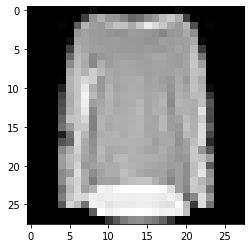

In [ ]:
# visualize a image with number taken from the image above
plt.imshow(test_dataset[9362][0].reshape(28,28), cmap='gist_gray');